# Importation et données globales

In [ ]:
import numpy as np
import healpy as hp
import matplotlib.pyplot as plt
plt.rcParams.update({
    'xtick.top': True,
    'ytick.right': True,
    'xtick.direction': 'in',
    'ytick.direction': 'in',
    'xtick.major.size': 6,
    'ytick.major.size': 6,
    'xtick.major.width': 1.5,
    'ytick.major.width': 1.5,
    'xtick.labelsize': 15,
    'ytick.labelsize': 15  
})

# Définition des paramètres
nside = 64 # Résolution HEALPix
npix = hp.nside2npix(nside) # Nombre total de pixels = nside**2 * 12

# Chargement du fichier
data = np.loadtxt("nph1.0e+06_dyn0.005-0.20-0.20_wind0.050-0.05-0.30_rpkt.txt", skiprows=1)
nx, ny, nz = data[:,0], data[:,1], data[:,2] # Coordonnées
e_erg = data[:,5] # Énergie en erg
time = data[:,3] # Temps en jours
t_days= time
nu = data[:,4] # Fréquence en Hz
nu_Hz = data[:,4]  # Fréquence

# Paramètres de conversion

erg_to_J = 1e-7
day_to_s = 24 * 3600

t_s = t_days * day_to_s
e_J = e_erg * erg_to_J

pix = hp.vec2pix(nside, nx, ny, nz) # Renvoit la position du pixel pour chaque vecteur nx ny nz 

# Energy vs angle

In [2]:
import numpy as np
import healpy as hp
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.animation import PillowWriter
import os


t_s = t_days * day_to_s
e_J = e_erg * erg_to_J

# Angles sphériques 
theta = np.arccos(nz)
phi = np.arctan2(ny, nx)

def sanity_check_energy_evolution():
    """
    Analyse l'évolution de l'énergie en fonction du temps pour différents angles
    """
    
    # Définir les angles de référence à analyser
    angles_ref = {
        'North Pole': 0,
        rf'$\theta=45^\circ$': np.pi/4, 
        'Equator': np.pi/2,
        rf'$\theta=135^\circ$': 3*np.pi/4,
        'South Pole': np.pi
    }
    
    # Grille temporelle pour l'analyse
    t_bins = np.linspace(t_days.min(), t_days.max(), 500) 
    t_centers = 0.5 * (t_bins[1:] + t_bins[:-1])
    
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    axes = axes.flatten()
    
    colors = ['red', 'orange', 'green', 'blue', 'purple']
    
    # Pour chaque angle de référence
    for i, (name, theta_ref) in enumerate(angles_ref.items()):
        # Sélectionner les photons dans un cône autour de cet angle
        cone_radius = 0.25  # Ajustable - augmenter pour tenir compte d'un plus grand cone
        mask_direction = np.abs(theta - theta_ref) < cone_radius
        
        if not np.any(mask_direction):
            continue
        
        # Évolution temporelle de l'énergie dans cette direction
        energy_vs_time, _ = np.histogram(t_days[mask_direction], 
                                       bins=t_bins, 
                                       weights=e_erg[mask_direction])
        
        # Plot principal - energie vs temps
        axes[i].loglog(t_centers, energy_vs_time, 
                    color=colors[i], linewidth=2, marker='o', markersize=4)
        axes[i].set_xlabel('t(days)')
        axes[i].set_ylabel('Energy (erg)')
        axes[i].set_title(name)
        axes[i].grid(True, alpha=0.3)
        
        # Statistiques
        total_energy = np.sum(e_erg[mask_direction])
        n_photons = np.sum(mask_direction)
        peak_time = t_centers[np.argmax(energy_vs_time)]

        
        # Annotation sur le graphique
        axes[i].text(0.98, 0.98, 
                f'# photons ={n_photons:,}\nE_tot={total_energy:.1e} erg\nPic: {peak_time:.1f}j',
                transform=axes[i].transAxes, 
                verticalalignment='top',
                horizontalalignment='right',
                bbox=dict(boxstyle="round,pad=0.3", facecolor="white", alpha=0.8))
    
    # Plot de comparaison globale
    axes[5].set_title('All directions comparison')
    for i, (name, theta_ref) in enumerate(angles_ref.items()):
        mask_direction = np.abs(theta - theta_ref) < 0.25
        if np.any(mask_direction):
            energy_vs_time, _ = np.histogram(t_days[mask_direction], 
                                           bins=t_bins, 
                                           weights=e_erg[mask_direction])
            axes[5].loglog(t_centers, energy_vs_time, 
                        color=colors[i], linewidth=2, label=name)
    
    axes[5].set_xlabel('t(days)')
    axes[5].set_ylabel('Energy (erg)')
    axes[5].set_yscale('log')
    axes[5].legend(fontsize=9)
    axes[5].grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig('energy_evolution_by_angle.png', dpi=150, bbox_inches='tight')
    plt.show()


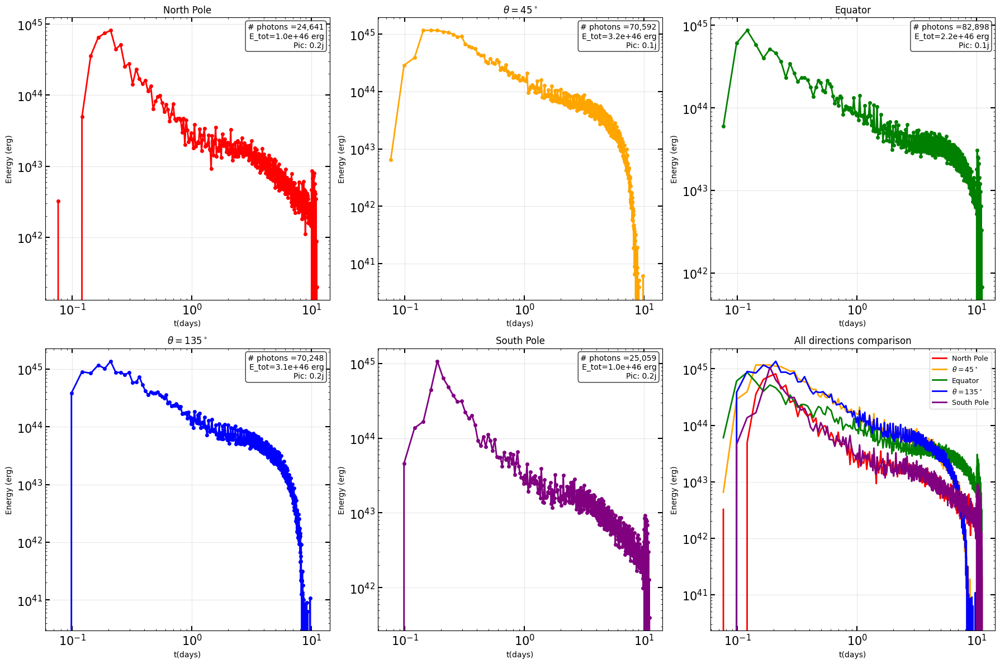

In [3]:
sanity_check_energy_evolution()

- généralisation à plus d'angles

In [4]:
import numpy as np
import healpy as hp
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import matplotlib.cm as cm
from torch import norm

def analyze_energy_vs_time_and_angle():
    """
    Analyse complète de l'évolution de l'énergie en fonction du temps et de l'angle
    """
    
    # Paramètres de la grille d'analyse
    n_theta_bins = 20  # Nombre de bins angulaires
    n_time_bins = 50   # Nombre de bins temporels
    cone_radius = 0.15  # Rayon du cône pour l'échantillonnage angulaire
    
    # Grilles d'analyse
    theta_bins = np.linspace(0, np.pi, n_theta_bins + 1)
    theta_centers = 0.5 * (theta_bins[1:] + theta_bins[:-1])
    
    t_bins = np.linspace(t_days.min(), t_days.max(), n_time_bins + 1)
    t_centers = 0.5 * (t_bins[1:] + t_bins[:-1])
    
    # Matrice énergie(temps, angle)
    energy_matrix = np.zeros((n_time_bins, n_theta_bins))
    photon_count_matrix = np.zeros((n_time_bins, n_theta_bins))

    
    # Calcul pour chaque angle
    for j, theta_center in enumerate(theta_centers):
        # Sélection des photons dans un cône autour de cet angle
        mask_direction = np.abs(theta - theta_center) < cone_radius
        
        if np.any(mask_direction):
            # Évolution temporelle pour cet angle
            energy_vs_time, _ = np.histogram(t_days[mask_direction], 
                                           bins=t_bins, 
                                           weights=e_erg[mask_direction])
            
            photon_count, _ = np.histogram(t_days[mask_direction], bins=t_bins)
            
            energy_matrix[:, j] = energy_vs_time
            photon_count_matrix[:, j] = photon_count
    
    plt.figure(figsize=(12, 8))
    
    # Masquer les valeurs nulles 
    energy_plot = energy_matrix.copy()
    energy_plot[energy_plot == 0] = np.nan
    
    # Conversion des axes pour l'affichage - meshgrid pour rassembler les données
    T_mesh, Theta_mesh = np.meshgrid(t_centers, np.degrees(theta_centers))
    
    im = plt.pcolormesh(T_mesh, Theta_mesh, energy_plot.T, 
                       norm=LogNorm(vmin=np.nanmin(energy_plot[energy_plot > 0]), 
                                   vmax=np.nanmax(energy_plot)), # lognorm pour mieux visualiser la variation énergie
                       cmap='hot', shading='auto')
    
    plt.xscale('log')
    plt.xlabel('t(days)', fontsize=16)
    plt.ylabel(rf'Viewing Angle $\theta$ (degrees)', fontsize=16)
    plt.title('Energy Evolution', fontsize=18)
    
    # Colorbar
    cbar = plt.colorbar(im, pad=0.02)
    cbar.set_label('Energy (erg)', fontsize=14)
    
    plt.tight_layout()
    plt.savefig('energy_heatmap_main.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    # 4 subplots d'analyse
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    
    #1 : Profils temporels pour quelques angles sélectionnés
    ax1 = axes[0, 0]
    
    selected_angles_idx = [0, n_theta_bins//4, n_theta_bins//2, 3*n_theta_bins//4, n_theta_bins-1]
    colors = ['red', 'orange', 'green', 'blue', 'purple']
    
    for i, idx in enumerate(selected_angles_idx):
        profile = energy_matrix[:, idx]
        mask_nonzero = profile > 0
        if np.any(mask_nonzero):
            ax1.loglog(t_centers[mask_nonzero], profile[mask_nonzero], 
                          color=colors[i], linewidth=2, marker='o', markersize=4,
                          label=rf'$\theta$ = {np.degrees(theta_centers[idx]):.0f}°')
    
    ax1.set_xlabel('t(days)', fontsize=12)
    ax1.set_ylabel('Energy (erg)', fontsize=12)
    ax1.set_title('Temporal Profiles', fontsize=14)
    ax1.legend(fontsize=10)
    ax1.grid(True, alpha=0.3)
    
    # 2: Profils angulaires pour quelques temps sélectionnés
    ax2 = axes[0, 1]
    
    selected_times_idx = [0, n_time_bins//4, n_time_bins//2, 3*n_time_bins//4, n_time_bins-1]
    
    for i, idx in enumerate(selected_times_idx):
        profile = energy_matrix[idx, :]
        mask_nonzero = profile > 0
        if np.any(mask_nonzero):
            ax2.semilogy(np.degrees(theta_centers[mask_nonzero]), profile[mask_nonzero], 
                        color=colors[i], linewidth=2, marker='s', markersize=4,
                        label=f't = {t_centers[idx]:.2f}d')
    
    ax2.set_xlabel(rf'Viewing Angle $\theta$ (degrees)', fontsize=12)
    ax2.set_ylabel('Energy (erg)', fontsize=12)
    ax2.set_title('Angular Profiles', fontsize=14)
    ax2.legend(fontsize=10)
    ax2.grid(True, alpha=0.3)
    
    # 3: Énergie totale vs temps (intégrée sur tous les angles)
    ax3 = axes[1, 0]
    
    total_energy_vs_time = np.sum(energy_matrix, axis=1)
    mask_nonzero = total_energy_vs_time > 0
    
    ax3.loglog(t_centers[mask_nonzero], total_energy_vs_time[mask_nonzero], 
              'black', linewidth=3, marker='o', markersize=3)
    ax3.set_xlabel('t(days)', fontsize=12)
    ax3.set_ylabel('Total Energy (erg)', fontsize=12)
    ax3.set_title('Total Energy vs Time', fontsize=14)
    ax3.grid(True, alpha=0.3)
    
    # Plot 4: Distribution angulaire totale (intégrée sur tous les temps)
    ax4 = axes[1, 1]
    
    total_energy_vs_angle = np.sum(energy_matrix, axis=0)
    mask_nonzero = total_energy_vs_angle > 0
    
    ax4.semilogy(np.degrees(theta_centers[mask_nonzero]), total_energy_vs_angle[mask_nonzero], 
                'darkred', linewidth=3, marker='s', markersize=4)
    ax4.set_xlabel(rf'Viewing Angle $\theta$(degrees)', fontsize=12)
    ax4.set_ylabel('Total Energy (erg)', fontsize=12)
    ax4.set_title('Total Energy vs Angle', fontsize=14)
    ax4.grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.savefig('energy_analysis_subplots.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    # Statistiques globales
    print(f"Énergie totale: {np.sum(energy_matrix):.2e} erg")
    print(f"Temps du pic global: {t_centers[np.argmax(total_energy_vs_time)]:.2f} jours")
    print(f"Angle du pic global: {np.degrees(theta_centers[np.argmax(total_energy_vs_angle)]):.1f}°")
    
    # Analyse de l'anisotropie grâce à la distribution angulaire totale
    # On regarde le contraste entre l'angle de maximum et minimum normalisé par la valeur maximale
    anisotropy = (np.max(total_energy_vs_angle) - np.min(total_energy_vs_angle[total_energy_vs_angle > 0])) / np.max(total_energy_vs_angle)
    print(rf"Anisotropie angulaire: {anisotropy:.2%}")
    
    return energy_matrix, t_centers, theta_centers


def create_3d_visualization():
    """
    Crée une visualisation 3D de l'énergie en fonction du temps et de l'angle
    """
    from mpl_toolkits.mplot3d import Axes3D
    
    # Réutilise les données de l'analyse précédente
    energy_matrix, t_centers, theta_centers = analyze_energy_vs_time_and_angle()
    
    fig = plt.figure(figsize=(14, 10))
    ax = fig.add_subplot(111, projection='3d')
    
    # Création des meshgrids pour la surface 3D
    T_mesh, Theta_mesh = np.meshgrid(t_centers, np.degrees(theta_centers))
    Energy_mesh = energy_matrix.T # Transposé pour correspondre aux dimensions
    
    # Masquer les valeurs nulles
    Energy_mesh[Energy_mesh == 0] = np.nan
    
    # Surface 3D
    surf = ax.plot_surface(T_mesh, Theta_mesh, np.log10(Energy_mesh), 
                          cmap='viridis', alpha=0.8, 
                          linewidth=0)
    
    ax.set_xlabel('t(day)', fontsize=12)
    ax.set_ylabel(rf'Viewing Angle $\theta$ (degrees)', fontsize=12)
    ax.set_zlabel('Energy (log(erg))', fontsize=12)
    ax.set_title('3D Energy Distribution', fontsize=14)
    
    # Colorbar
    fig.colorbar(surf, ax=ax, shrink=0.5, aspect=20, 
                 label='Energy log(erg)', norm=LogNorm())
    
    plt.savefig('energy_3d_visualization.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    return fig, ax



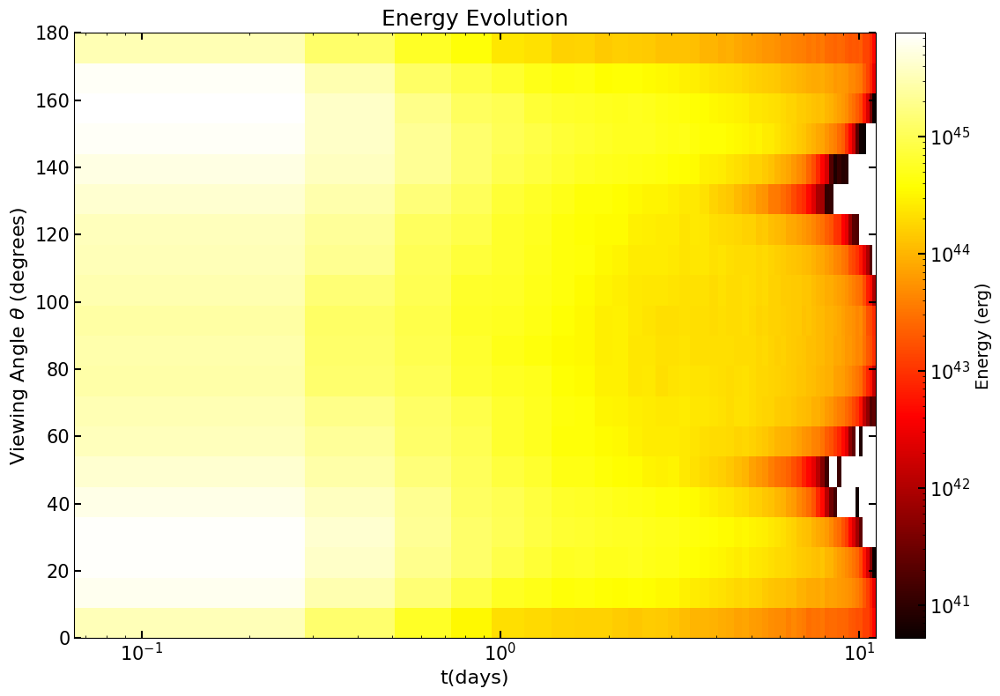

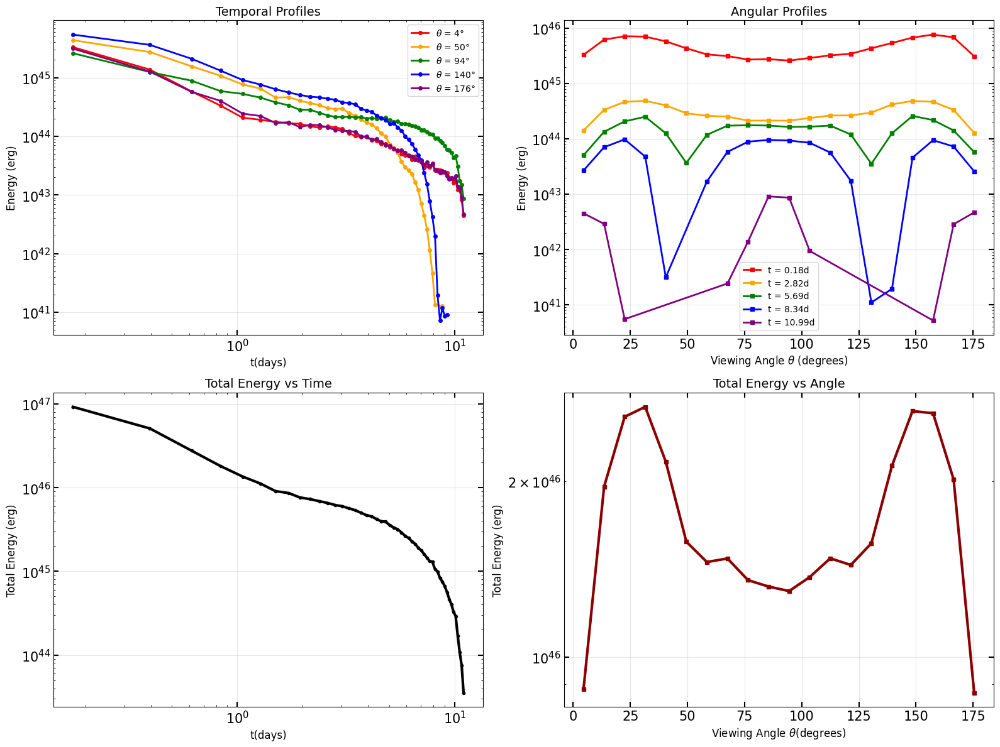

Énergie totale: 3.48e+47 erg
Temps du pic global: 0.18 jours
Angle du pic global: 31.5°
Anisotropie angulaire: 67.53%


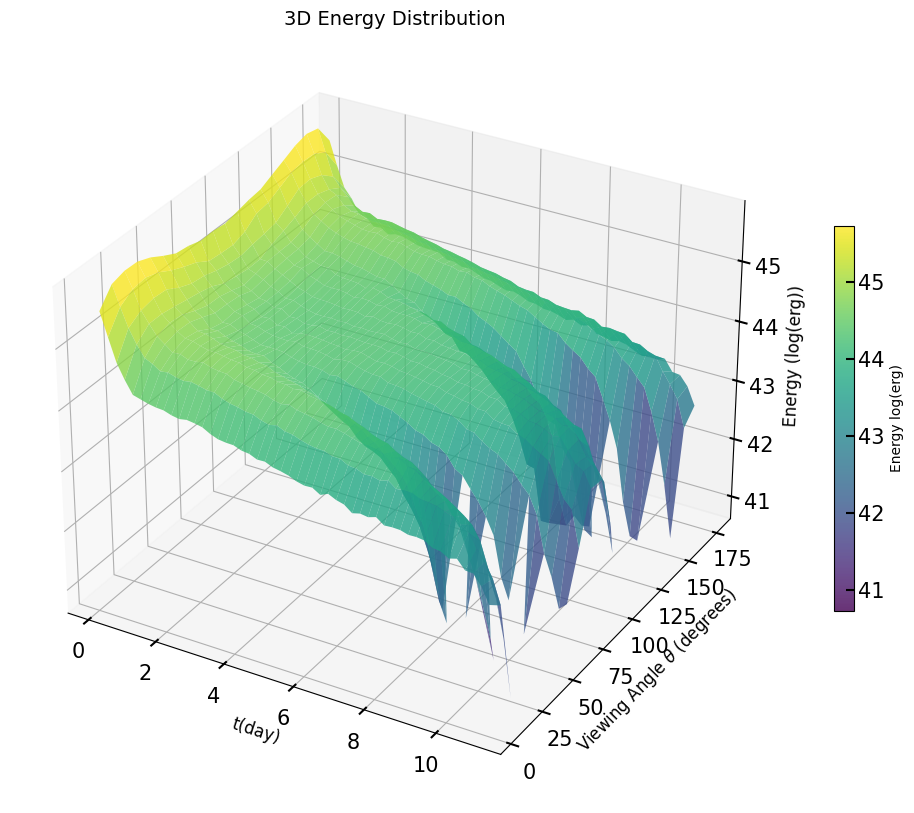

(<Figure size 1400x1000 with 2 Axes>,
 <Axes3D: title={'center': '3D Energy Distribution'}, xlabel='t(day)', ylabel='Viewing Angle $\\theta$ (degrees)', zlabel='Energy (log(erg))'>)

In [5]:
create_3d_visualization()

- Angular distribution : Anisotropie de plus en plus marquée avec le temps. On le voit aussi sur le plot de l'énergie totale en focntion de l'angle

- Premier plot + Plot 3D : On observe la tendance plutot polaire et équatoriale -> anisotropie de la distribution angulaire de l'énergie

## Anisotropie de la distribution angulaire de l'énergie
- Comparaison sur une map healpy : On peut regarder la symétrie de la map à différents temps (early, mid, late) pour voir si l'anisotropie évolue dans le temps.

In [ ]:
def compute_hemispheric_anisotropy(energy_map,plot=True):
    """
    Calcule l'anisotropie énergétique Nord vs Sud.
    - energy_map à un temps donné (array de taille npix)

    """



    # vecteurs pixel
    x, y, z = hp.pix2vec(nside, np.arange(npix))
    x = np.asarray(x)
    y = np.asarray(y)
    z = np.asarray(z)

    # mask nord / sud (z>0 nord, z<0 sud). Les z==0 (plan équateur) sont exclus
    mask_north = z > 0.0
    mask_south = ~mask_north

    E_north = np.sum(energy_map[mask_north])
    E_south = np.sum(energy_map[mask_south])

    # anisotropie relative (North - South) / (North + South) ; valeur entre -1 et 1
    denom = (E_north + E_south)
    anisotropy_rel = (E_north - E_south) / denom if denom != 0 else 0.0

    # carte miroir équatoriale : pour chaque pixel, trouver le pixel symétrique par rapport à l'équateur
    mirror_idx = hp.vec2pix(nside, x, y, -z)  # inverse le signe de z pour miroir équatorial
    mirror_idx = np.asarray(mirror_idx, dtype=int)

    # différence pixel vs pixel miroir (nord - sud)
    diff_map = energy_map - energy_map[mirror_idx]

    if plot:

        # carte différence miroir (linear) : positive => pixel a plus d'énergie que son miroir équatorial
        # symétriser l'échelle pour RdBu
        absmax = np.nanmax(np.abs(diff_map))

        hp.mollview(diff_map, title="Energy - Equatorial-mirror (North - South local)", unit="erg",
                    cmap="RdBu_r", min=-absmax, max=absmax)

        plt.show()

        # plus claire : carte relative local ( (E - E_mirror) / (E + E_mirror) ) 
        denom_local = energy_map + energy_map[mirror_idx] # Somme locale des énergies nord/sud
        with np.errstate(divide='ignore', invalid='ignore'): # ignor division par 0
            rel_map = np.where(denom_local > 0, (energy_map - energy_map[mirror_idx]) / denom_local, 0.0)
            # Map relative : valeur entre -1 et 1, où +1 signifie que tout l'énergie est dans le pixel nord, -1 dans le pixel sud - 0 signifie égalité

        hp.mollview(rel_map, title="Local relative asymmetry (E - E_mirror)/(E + E_mirror)",
                    unit="", cmap="RdBu_r", min=-1, max=1)
        plt.show()
        # voir anisotropy_rel pour asymétrie globale nord/sud
        print(f"Global North-South energy asymmetry: {anisotropy_rel:.2%} (North > South)" if anisotropy_rel > 0 else f"Global North-South energy asymmetry: {anisotropy_rel:.2%} (South > North)")
        


Analyzing hemispheric anisotropy for time ~ 0.5 days


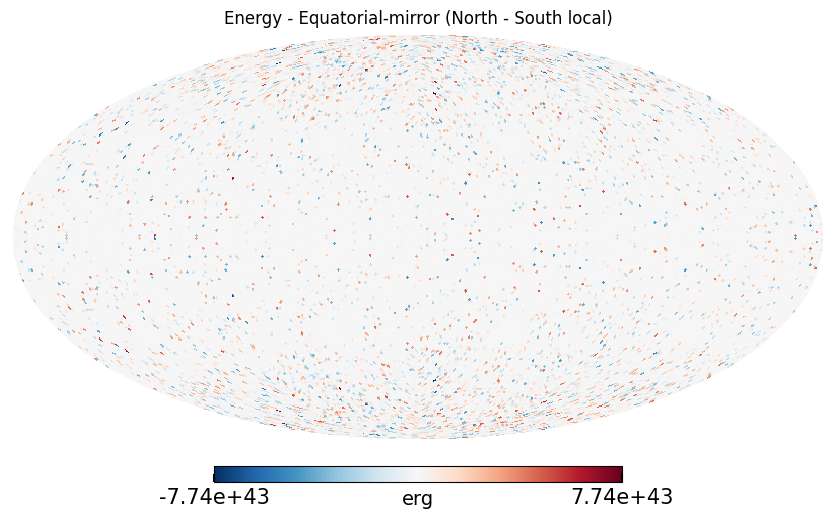

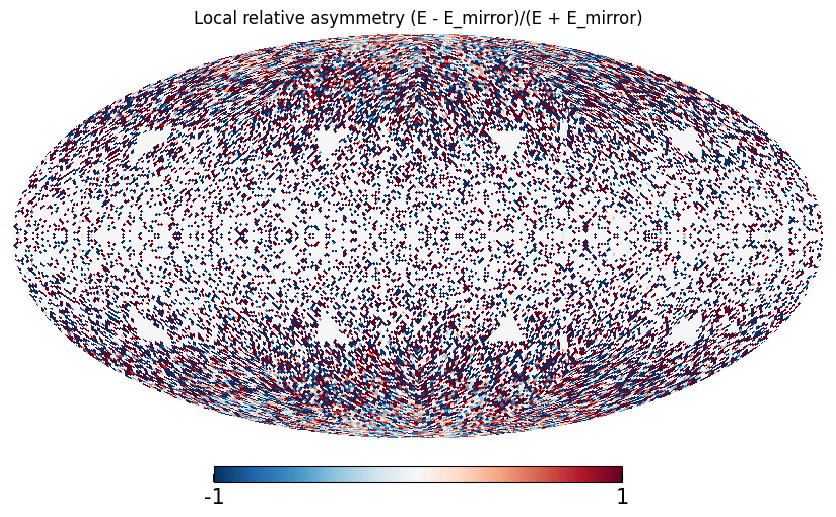

Global North-South energy asymmetry: -0.64% (South > North)
Analyzing hemispheric anisotropy for time ~ 1.0 days


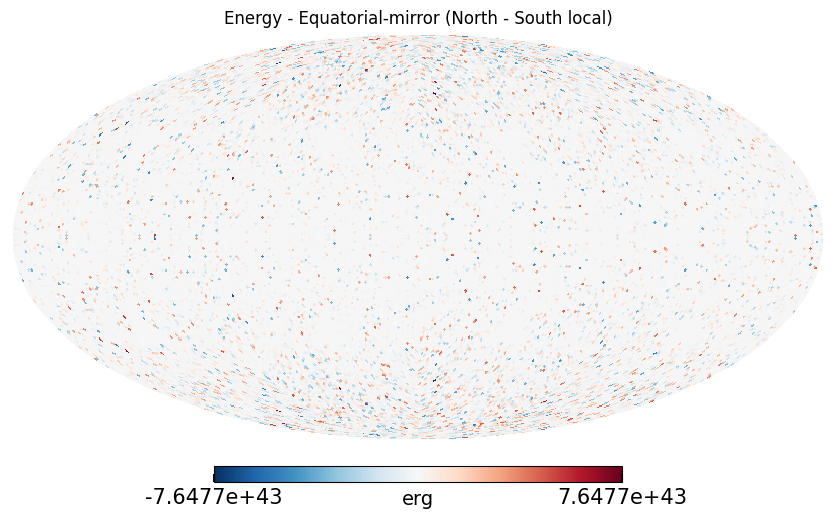

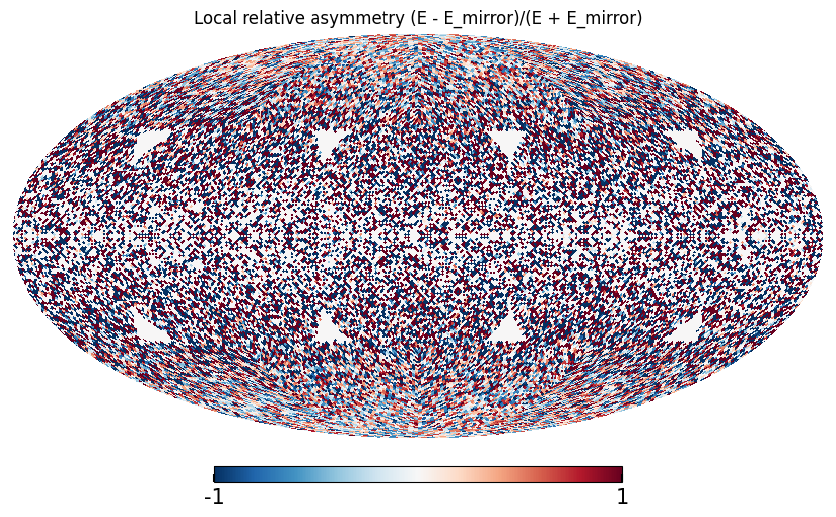

Global North-South energy asymmetry: 0.01% (North > South)
Analyzing hemispheric anisotropy for time ~ 10.0 days


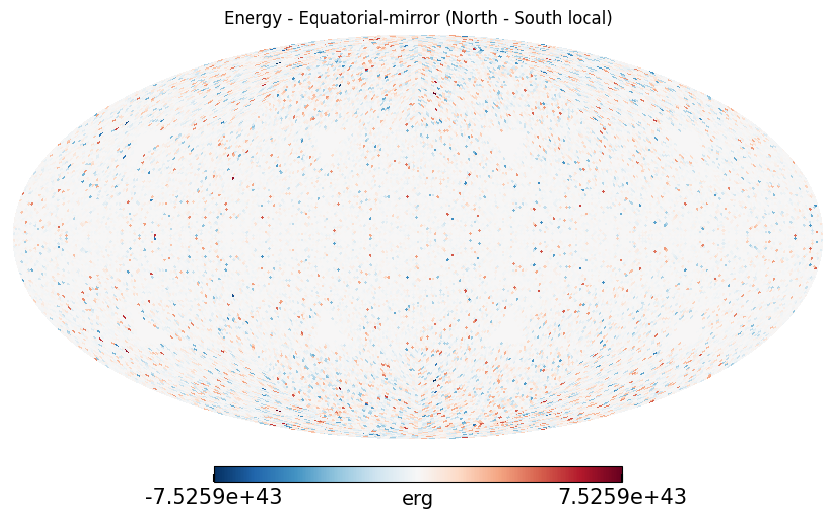

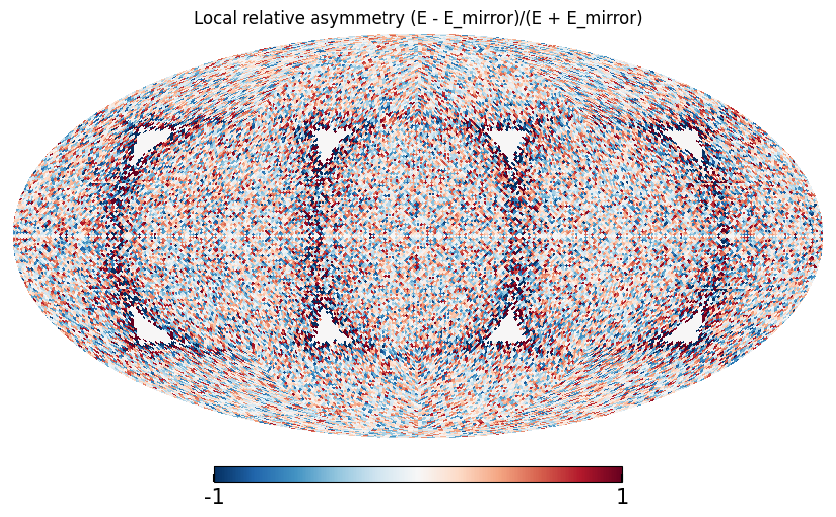

Global North-South energy asymmetry: -0.18% (South > North)


In [42]:
# calcul de quelques map d'énergie en fonction du temps
time_slices_days = [0.5, 1.0, 10.0] # jours
for t_slice in time_slices_days:
    # mask pour le temps proche de t_slice

    mask_time =  (t_days <= t_slice ) # On somme l'énergie jusqu'à t_slice

    # carte d'énergie pour ce temps
    energy_map = np.zeros(npix)
    if np.any(mask_time):
        np.add.at(energy_map, pix[mask_time], e_erg[mask_time])

    print(f"Analyzing hemispheric anisotropy for time ~ {t_slice} days")
    compute_hemispheric_anisotropy(energy_map, plot=True)

In [47]:
def compute_hemispheric_anisotropy_tot(plot=True):
    """
    Calcule l'anisotropie énergétique Nord vs Sud sur l'ensemble des données.
    """
    import os
    outdir="gw170817_memory_outputs"
    os.makedirs(outdir, exist_ok=True)


    # énergie intégrée par pixel (erg) final
    energy_map = np.bincount(pix, weights=e_erg, minlength=npix).astype(float) # bincounter pour sommer les énergies par pixel

    # vecteurs pixel
    x, y, z = hp.pix2vec(nside, np.arange(npix))
    x = np.asarray(x)
    y = np.asarray(y)
    z = np.asarray(z)

    # mask nord / sud (z>0 nord, z<0 sud). Les z==0 (plan équateur) sont exclus
    mask_north = z > 0.0
    mask_south = ~mask_north

    E_north = np.sum(energy_map[mask_north])
    E_south = np.sum(energy_map[mask_south])

    # anisotropie relative (North - South) / (North + South) ; valeur entre -1 et 1
    denom = (E_north + E_south)
    anisotropy_rel = (E_north - E_south) / denom *100  if denom != 0 else 0.0

    # carte miroir équatoriale : pour chaque pixel, trouver le pixel symétrique par rapport à l'équateur
    mirror_idx = hp.vec2pix(nside, x, y, -z)  # inverse le signe de z pour miroir équatorial
    mirror_idx = np.asarray(mirror_idx, dtype=int)

    # différence pixel vs pixel miroir (nord - sud)
    diff_map = energy_map - energy_map[mirror_idx]

    if plot:

        # carte différence miroir (linear) : positive => pixel a plus d'énergie que son miroir équatorial
        # symétriser l'échelle pour RdBu
        absmax = np.nanmax(np.abs(diff_map))

        hp.mollview(diff_map, title="Energy - Equatorial-mirror (North - South local)", unit="erg",
                    cmap="RdBu_r", min=-absmax, max=absmax)
        plt.savefig(os.path.join(outdir, "energy_north_minus_south_mollview.png"), dpi=150, bbox_inches="tight")
        plt.show()

        # plus claire : carte relative local ( (E - E_mirror) / (E + E_mirror) ) 
        denom_local = energy_map + energy_map[mirror_idx] # Somme locale des énergies nord/sud
        with np.errstate(divide='ignore', invalid='ignore'):
            rel_map = np.where(denom_local > 0, (energy_map - energy_map[mirror_idx]) / denom_local, 0.0)
            # Map relative : valeur entre -1 et 1, où +1 signifie que tout l'énergie est dans le pixel nord, -1 dans le pixel sud - 0 signifie égalité

        hp.mollview(rel_map, title="Local relative asymmetry (E - E_mirror)/(E + E_mirror)",
                    unit="", cmap="RdBu_r", min=-1, max=1)
        plt.savefig(os.path.join(outdir, "energy_north_minus_south_relative_mollview.png"), dpi=150, bbox_inches="tight")
        plt.show()
        # voir anisotropy_rel pour asymétrie globale nord/sud
        print(f"Global North-South energy asymmetry: {anisotropy_rel:.2%} (North > South)" if anisotropy_rel > 0 else f"Global North-South energy asymmetry: {anisotropy_rel:.2%} (South > North)")
        


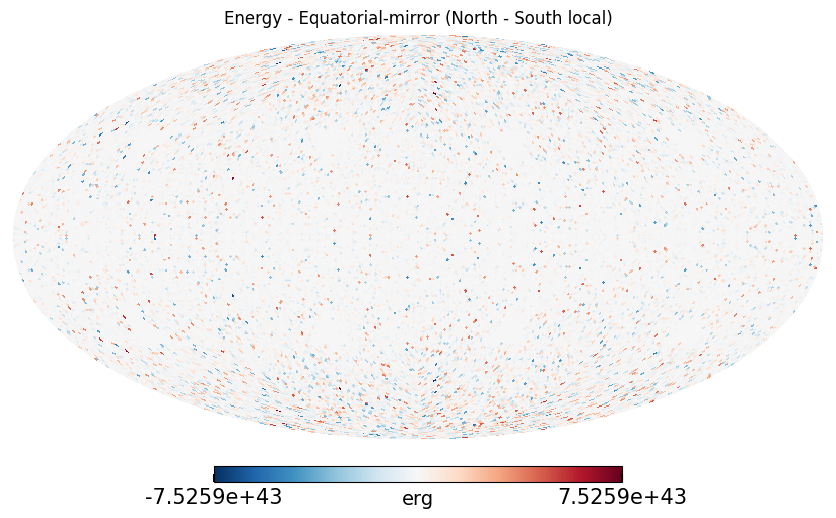

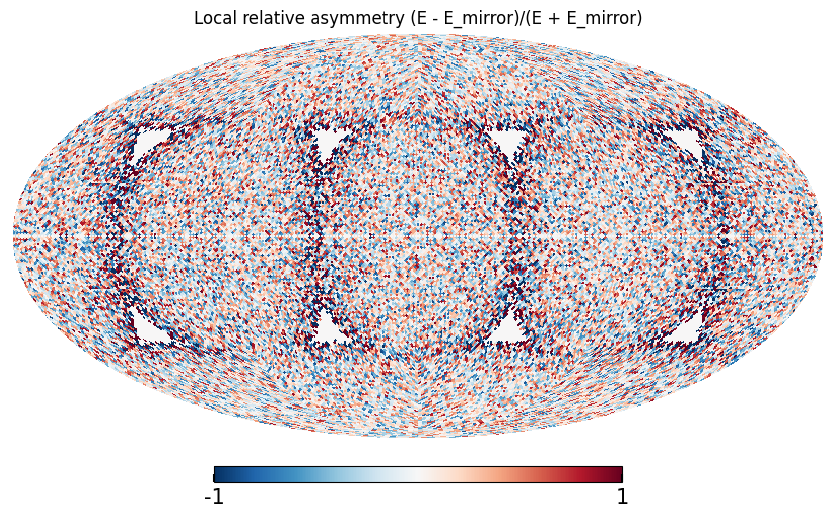

Global North-South energy asymmetry: -18.74% (South > North)


In [48]:
compute_hemispheric_anisotropy_tot(plot=True)

# Spectre d'énergie pour early - mid - late times

/tmp/ipykernel_15949/1493242010.py:3: UserWarning: Wswiglal-redir-stdio:

SWIGLAL standard output/error redirection is enabled in IPython.
This may lead to performance penalties. To disable locally, use:

with lal.no_swig_redirect_standard_output_error():
    ...

To disable globally, use:

lal.swig_redirect_standard_output_error(False)

Note however that this will likely lead to error messages from
LAL functions being either misdirected or lost when called from
Jupyter notebooks.

To suppress this warning, use:

import warnings
warnings.filterwarnings("ignore", "Wswiglal-redir-stdio")
import lal

  from lal import C_SI
/opt/pycbc/.local/lib/python3.11/site-packages/numpy/_core/fromnumeric.py:3860: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/opt/pycbc/.local/lib/python3.11/site-packages/numpy/_core/_methods.py:145: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


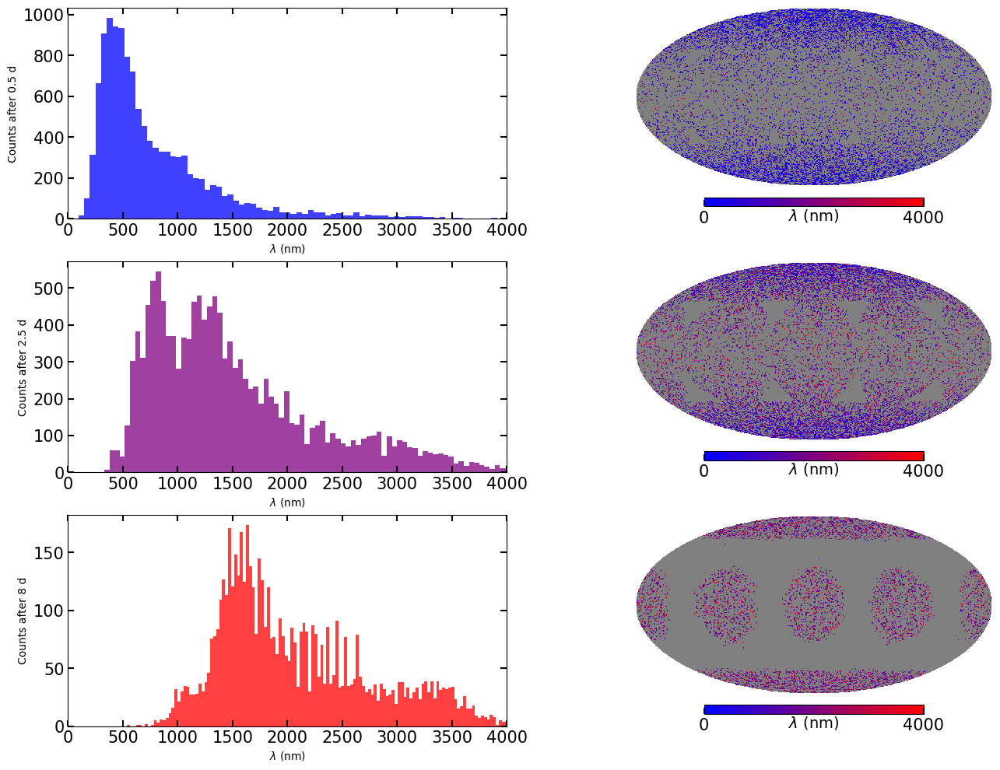

In [7]:
from matplotlib import cm as mpl_cm
from matplotlib.colors import ListedColormap
from lal import C_SI

time_phase = [0.5, 2.5, 8] # Check l'évolution de la longueur d'onde sur 3 temps diff
colors = ['blue', 'purple', 'red']

lambda_m = C_SI / nu_Hz # en m
lambda_nm = lambda_m * 1e9 # cnvertion en nm
# Plot des hist et molview pour early, mid et late time dans une figure 3 x 2
t_days = data[:,3]
plt.figure(figsize=(16,12), dpi=100)

for i, (t, c) in enumerate(zip(time_phase, colors)):
    # Masque temporel
    mask_time = (t_days >= t - 0.1) & (t_days <= t + 0.1)
    
    # Données pour ce temps
    pix_frame = pix[mask_time]
    lambda_frame = lambda_nm[mask_time]
    
    # Histogramme de la longueur d'onde
    plt.subplot(3, 2, 2*i + 1)
    plt.hist(lambda_frame, bins=650, color=c, alpha=0.75)
    plt.xlabel("$\lambda$ (nm)")
    plt.xlim(0, 4000)
    plt.ylabel(f"Counts after {t} d")

    
    # Carte de longueur d'onde moyenne
    lambda_map = np.full(npix, np.nan)
    
    for p in range(npix):
        mask_pixel = (pix_frame == p)
        lambdas = lambda_frame[mask_pixel]
        lambda_map[p] = np.mean(lambdas)
    
    plt.subplot(3, 2, 2*i + 2)
    # Utilise la moitié de la cmap brg
    cm = mpl_cm.brg(np.linspace(0, 0.5, 256))
    cm = ListedColormap(cm)

    hp.mollview(lambda_map, 
                unit='$\lambda$ (nm)',
                title = '',
                cmap=cm,
                norm='linear',
                min = 0,
                max = 4000,
                hold=True,
                cbar= True)


# Évolution de la luminosité en fonction du temps 

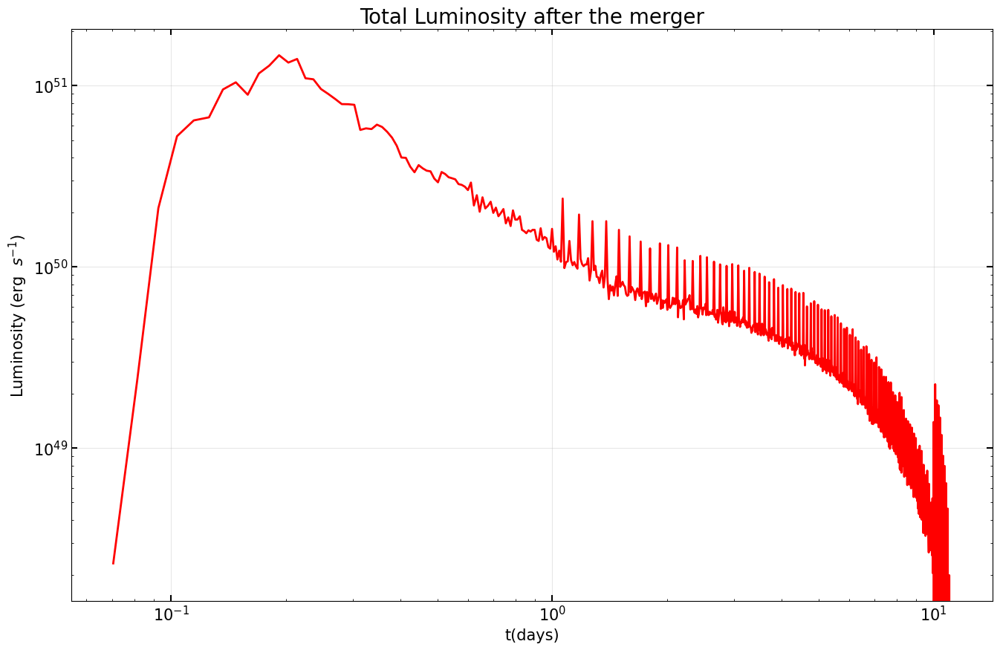

In [8]:
from lal import PC_SI
# Conversions + constante
erg_to_J = 1e-7
day_to_s = 24 * 3600
r_m = 40 * 1e6 * PC_SI
t_s = t_days

#Binning temporel
nbins_time = 1000
t_bins = np.linspace(t_s.min(), t_s.max(), nbins_time)
dt = np.median(np.diff(t_bins)) # pas de temps médian
nt = len(t_bins) - 1 # Nombre d'intervalles de temps

# énergie par pixel et par pas de temps
maps_erg= np.zeros((nt, npix))
for i in range(nt):
    mask = (t_s >= t_bins[i]) & (t_s < t_bins[i + 1])
    np.add.at(maps_erg[i], pix[mask], e_erg[mask]) # maps_erg est une matrice (nt, npix) donnant l'énergie par pixel pour chaque temps

# Luminosité par pixel et par pas de temps
dE_dt = maps_erg / dt # J/s
dOmega= 4 * np.pi / npix # stéradian par pixel
dL_dOmega = dE_dt / dOmega

# Plot de la luminosité totale en fonction du temps
L_tot = dL_dOmega.sum(axis=1)
t_centers_days = 0.5 * (t_bins[1:] + t_bins[:-1])

plt.figure(figsize=(16,10))
plt.semilogx(t_centers_days, L_tot, color='red', linewidth=2)
plt.yscale('log')
plt.xlabel('t(days)', fontsize=15)
plt.ylabel('Luminosity (erg $~s^{-1}$)', fontsize=15)
plt.title('Total Luminosity after the merger', fontsize=20)
plt.tick_params(top=True, right=True, axis='both', which='major', labelsize=15, direction='in', length=6, width=1.5)
plt.grid(True, alpha=0.3)

plt.show()

"Oscillation" de la luminosité après 1 jour + pic à 10 jours ? 

Je me serai plutot attendu à une décroissance régulière. Problème de binning linéaire ?
- t petit : bins trop larges → lissage excessif, perte d'information
- t >> 1 : bins trop fins → peu d'événements par bin → bruit élevé alors que peu de variation 


 -> Test avec un binning plus fin au début mais plus gros sur la fin = logspace

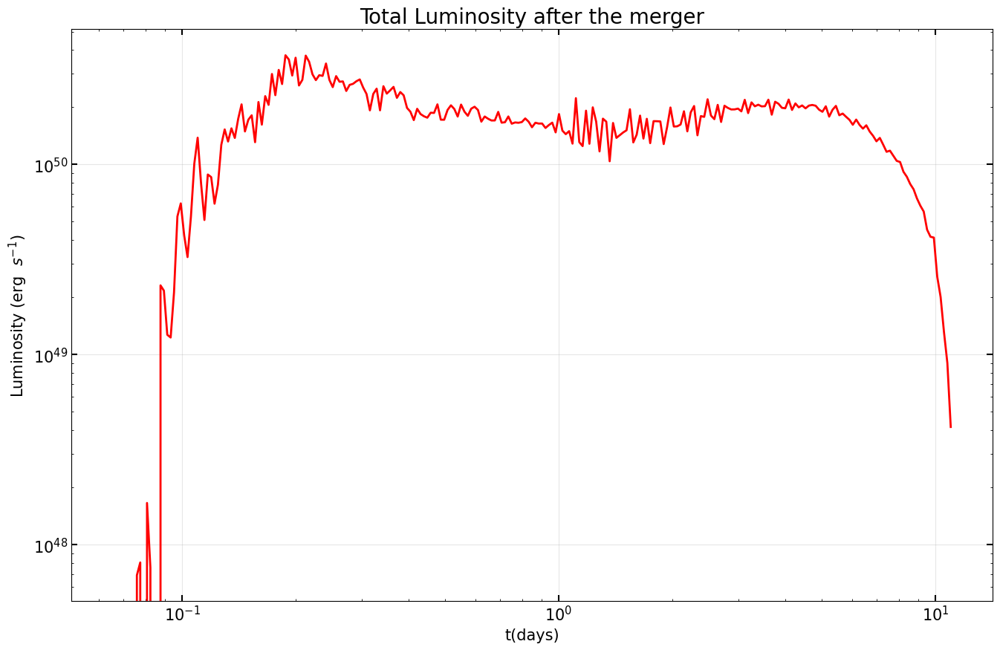

In [9]:
from lal import G_SI, PC_SI, C_SI
# Conversions + constante
erg_to_J = 1e-7
day_to_s = 24 * 3600

#Binning temporel 
nbins_time = 250
t_bins = np.logspace(np.log10(t_days.min()), np.log10(t_days.max()), nbins_time) # bornes des intervalles de temps en logspace pour éviter artefacts
dt = np.median(np.diff(t_bins)) # pas de temps médian 
nt = len(t_bins) - 1 # Nombre d'intervalles de temps

# Énergie par pixel et par pas de temps 
maps_erg= np.zeros((nt, npix))
for i in range(nt):
    mask = (t_days >= t_bins[i]) & (t_days < t_bins[i + 1])
    np.add.at(maps_erg[i], pix[mask], e_erg[mask]) # maps_erg est une matrice (nt, npix) donnant l'énergie par pixel pour chaque temps

# Luminosité par pixel et par pas de temps
dE_dt = maps_erg / dt # erg/s
dL_dOmega = dE_dt / dOmega
# Plot de la luminosité totale en fonction du temps
L_tot = dL_dOmega.sum(axis=1)
t_centers_days = 0.5 * (t_bins[1:] + t_bins[:-1])

plt.figure(figsize=(16,10)) 
plt.loglog(t_centers_days, L_tot, color='red', linewidth=2)
plt.xlabel('t(days)', fontsize=15)
plt.ylabel('Luminosity (erg $~s^{-1}$)', fontsize=15)
plt.title('Total Luminosity after the merger', fontsize=20)
plt.tick_params(top=True, right=True, axis='both', which='major', labelsize=15, direction='in', length=6, width=1.5)
plt.grid(True, alpha=0.3)

plt.show()

***Remarque*** : Un pic de luminosité semble encore apparaitre à 10jours

---

# Calcul de l'effet mémoire en jauge TT

- Fonction calculant la projection TT (projecteur) 
- Calcul du tenseur terme à terme

In [2]:
def apply_TT_projection(n_observer):
    """
    Renvoie le projecteur TT pour un vecteur direction n .
    """
    n = n_observer 
    n = np.asarray(n, dtype=float)
    n = n / np.linalg.norm(n)
    
    # Projecteur transverse
    P = np.eye(3) - np.outer(n, n) # P = \delta_ij - n'_i n'_j -> n' = n_observateur 
    
    # Projecteur TT complet
    Lambda = np.zeros((3, 3, 3, 3))
    for i in range(3):
        for j in range(3):
            for k in range(3):
                for l in range(3):
                    Lambda[i,j,k,l] = P[i,k]*P[j,l] - 0.5 * P[i,j]*P[k,l]
    return Lambda

def TT_projection(T, n_observer):
    """
    Projette un tenseur n 3x3 sur sa partie transverse-traceless
    """
    Lambda = apply_TT_projection(n_observer)
    T_TT = np.einsum('ijkl,kl->ij', Lambda, T) # einsum fait la contraction sur les indices k et l en gardant i et j fixes
    return T_TT

- Vérification rapide 

In [14]:
n_observer = np.array([0, 0, 1]) # Observateur sur l'axe z

# Test d'un tenseur symétrique quelconque
T_test = np.array([[1, 2, 3],
                   [2, 0, 4],
                   [3, 4, 5]])
T_TT = TT_projection(T_test, n_observer)
print("Tenseur TT :\n", T_TT)
# Calcul de la trace du tenseur projeté
trace_TT = np.sum(np.diag(T_TT))
print(np.diag(T_TT))
print(f"Trace de T^TT_ij: {trace_TT}")
# Vérification transversalité: n'^i T^TT_ij = 0
transverse_check1 = np.dot(n_observer, T_TT)
transverse_check2 = np.dot(T_TT, n_observer)
print(f"Transversalité n'^i T^TT_ij: {np.max(np.abs(transverse_check1))}")
print(f"Transversalité T^TT_ij n'^j: {np.max(np.abs(transverse_check2))}")


Tenseur TT :
 [[ 0.5  2.   0. ]
 [ 2.  -0.5  0. ]
 [ 0.   0.   0. ]]
[ 0.5 -0.5  0. ]
Trace de T^TT_ij: 0.0
Transversalité n'^i T^TT_ij: 0.0
Transversalité T^TT_ij n'^j: 0.0


--- 

On peut maintenant calculer l'effet mémoire en jauge TT 

In [3]:
from lal import G_SI, PC_SI, C_SI
def compute_linear_memory_TT(obs_dir, nside=64, distance_Mpc=40.0, nbins_time=1000):
    """
    Calcule l'effet mémoire linéaire TT selon une direction d'observation donnée
    """
    # Conversions + constante
    erg_to_J = 1e-7
    day_to_s = 24 * 3600
    r_m = distance_Mpc * 1e6 * PC_SI

    t_s = t_days * day_to_s
    e_J = e_erg * erg_to_J

    # Initialisation Healpix 
    npix = 12 * nside * nside
    pix = hp.vec2pix(nside, nx, ny, nz)

    #Binning temporel 
    t_bins = np.linspace(t_s.min(), t_s.max(), nbins_time)
    dt = np.median(np.diff(t_bins)) # pas de temps médian 
    nt = len(t_bins) - 1 # Nombre d'intervalles de temps

    # Énergie par pixel et par pas de temps 
    maps_J = np.zeros((nt, npix))
    for i in range(nt):
        mask = (t_s >= t_bins[i]) & (t_s < t_bins[i + 1])
        np.add.at(maps_J[i], pix[mask], e_J[mask]) # maps_J est une matrice (nt, npix) donnant l'énergie par pixel pour chaque temps

    # Luminosité  
    dE_dt = maps_J / dt  # J/s
    dOmega = 4.0 * np.pi / npix  # stéradian par pixel
    dL_dOmega = dE_dt / dOmega  # Luminosité par pixel (J/s/sr)

    # Intégrale temporelle 
    cumulative_dL = np.cumsum(dL_dOmega * dt, axis=0)  # Somme sur axe temps 
    L_final = cumulative_dL[-1]  # Luminosité finale intégrée = dernier élément

    # Calcul de la mémoire TT
    # Pré-calcul des vecteurs unitaires pour chaque pixel
    
    factor = 4.0 * G_SI / (r_m * C_SI**4)
    
    vecs = np.array(hp.pix2vec(nside, np.arange(npix))).T # Renvoit les vecteurs unitaires pour chaque pixel sous la forme (npix, 3)

    eps = 1e-8 # Pour éviter la division par zéro dans 1/(1 - cos(theta))
    
    h_memory_map = np.zeros(npix) # Carte de la contribution mémoire pour chaque pixel
    for p in range(npix):
        if L_final[p] == 0: # Si pas d'énergie émise dans cette direction on skip
            continue
            
        n_vec = vecs[p]
        cos_theta = np.dot(n_vec, obs_dir) 
        den = 1.0 - cos_theta
        if den < eps:
            den = eps # Calcul du dénominateur
        
        # projection TT sur les vecteurs n 
        n_tensor_TT = TT_projection(np.outer(n_vec, n_vec), obs_dir) # Calcul de n_i n_j (tenseur 3x3) projeté TT dont la définition de Lambda dépend de n_observer
        
        # Calcul du tenseur de mémoire
        h_tensor = factor * L_final[p] * n_tensor_TT / den
        
        # Polarisation + : h_+ = -h_xx 
        h_plus = -h_tensor[0, 0] 
        h_memory_map[p] = h_plus # Contribution mémoire pour ce pixel

    # Calcul de la mémoire totale = somme sur tous les pixels
    h_memory_total = np.sum(h_memory_map)

    return h_memory_map, h_memory_total

/tmp/ipykernel_21847/1412408045.py:1: UserWarning: Wswiglal-redir-stdio:

SWIGLAL standard output/error redirection is enabled in IPython.
This may lead to performance penalties. To disable locally, use:

with lal.no_swig_redirect_standard_output_error():
    ...

To disable globally, use:

lal.swig_redirect_standard_output_error(False)

Note however that this will likely lead to error messages from
LAL functions being either misdirected or lost when called from
Jupyter notebooks.

To suppress this warning, use:

import warnings
warnings.filterwarnings("ignore", "Wswiglal-redir-stdio")
import lal

  from lal import G_SI, PC_SI, C_SI


Pour le cas de la projection $(n_x n_x)^{TT}$, on a une relation analytique donné dans l'article B.14

In [4]:
from lal import G_SI, PC_SI, C_SI
def compute_linear_memory_TT_2(obs_dir, nside=64, distance_Mpc=40.0, nbins_time=1000):
    """
    Calcule l'effet mémoire linéaire TT selon une direction d'observation donnée avec la formule analytique pour jauge TT selon xx
    """
    # Conversions + constante
    erg_to_J = 1e-7
    day_to_s = 24 * 3600
    r_m = distance_Mpc * 1e6 * PC_SI

    t_s = t_days * day_to_s
    e_J = e_erg * erg_to_J

    # Initialisation Healpix 
    npix = 12 * nside * nside
    pix = hp.vec2pix(nside, nx, ny, nz)


    #Binning temporel 
    t_bins = np.linspace(t_s.min(), t_s.max(), nbins_time)
    dt = np.median(np.diff(t_bins)) # pas de temps médian 
    nt = len(t_bins) - 1 # Nombre d'intervalles de temps

    # Énergie par pixel et par pas de temps 
    maps_J = np.zeros((nt, npix))
    for i in range(nt):
        mask = (t_s >= t_bins[i]) & (t_s < t_bins[i + 1])
        np.add.at(maps_J[i], pix[mask], e_J[mask]) # maps_J est une matrice (nt, npix) donnant l'énergie par pixel pour chaque temps

    # Luminosité  
    dE_dt = maps_J / dt  # J/s
    dOmega = 4.0 * np.pi / npix  # stéradian par pixel
    dL_dOmega = dE_dt / dOmega  # J/s/sr

    # Intégrale temporelle 
    cumulative_dL = np.cumsum(dL_dOmega * dt, axis=0)  # Somme sur axe temps 
    L_final = cumulative_dL[-1]  # Luminosité finale intégrée = dernier élément

    # Calcul de la mémoire TT
    # Pré-calcul des vecteurs unitaires pour chaque pixel
    
    factor = 4.0 * G_SI / (r_m * C_SI**4)
    
    vecs = np.array(hp.pix2vec(nside, np.arange(npix))).T # Renvoit les vecteurs unitaires pour chaque pixel sous la forme (npix, 3)

    eps = 1e-8 # Pour éviter la division par zéro dans 1/(1 - cos(theta))
    
    h_memory_map = np.zeros(npix) # Carte de la contribution mémoire pour chaque pixel
    for p in range(npix):
        if L_final[p] == 0: # Si pas d'énergie émise dans cette direction on skip
            continue
            
        n_vec = vecs[p]
        cos_theta = np.dot(n_vec, obs_dir) 
        den = 1.0 - cos_theta
        if den < eps:
            den = eps # Calcul du dénominateur
            
        theta = np.arccos(n_vec[2])
        phi = np.arctan2(n_vec[1], n_vec[0])
        
        # projection TT sur les vecteurs n <-- Changement : utilisation de la formule analytique directe
        n_tensor_TT = 0.5 * (1 - np.cos(theta)**2) *  (2 * np.cos(phi)**2 - 1) # Utilisation directe de la formule de projection TT sur la base décrite dans B.14
        
        # Calcul du tenseur de mémoire
        h_tensor = factor * L_final[p] * n_tensor_TT / den
        
        # Polarisation + : h_+ = -h_xx 
        h_plus = -h_tensor
        h_memory_map[p] = h_plus # Contribution mémoire pour ce pixel

    # Calcul de la mémoire totale = somme sur tous les pixels
    h_memory_total = np.sum(h_memory_map)

    return h_memory_map, h_memory_total

- Plot de qq maps pour voir comment évolue la mémoire + ordre de grandeur

Mémoire totale : 5.465420659864593e-27


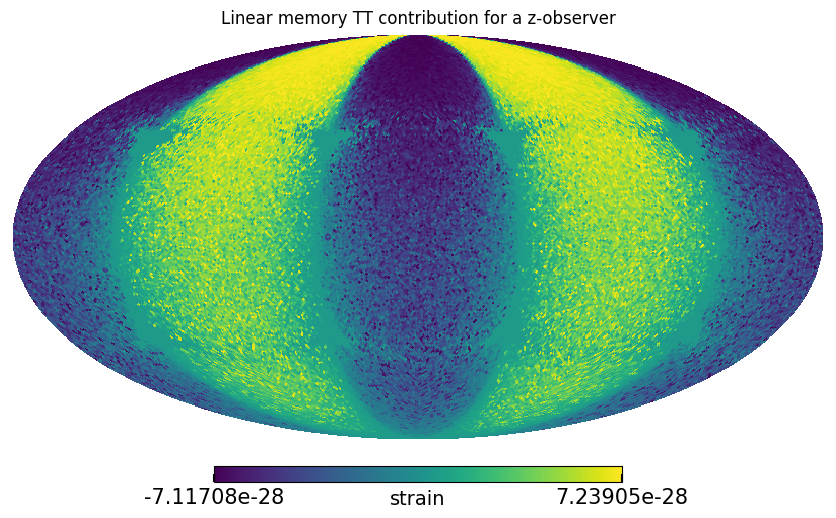

Mémoire totale (formule analytique) : 5.465420659864582e-27


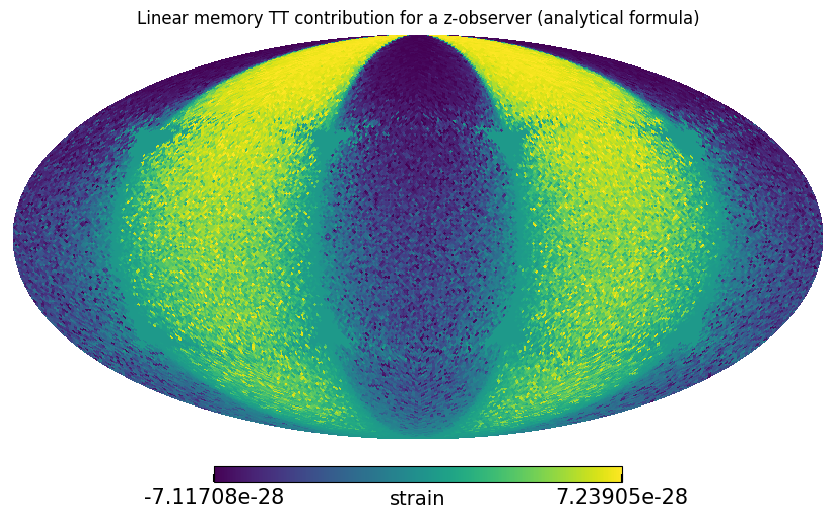

In [17]:
h_map, h_total = compute_linear_memory_TT(
    [0,0,1], # z-observer
    nside=64,
    distance_Mpc=40.0 # Distance pour GW170817
)

print("Mémoire totale :", h_total)
# Plot molview de l'effet mémoire
hp.mollview(h_map,
            title="Linear memory TT contribution for a z-observer",
            unit="strain",
            norm = 'hist' #histogramme des valeurs -> permet de mieux voir les variations + et - 
            )
plt.show()
# Second test avec la formule analytique
h_map2, h_total2 = compute_linear_memory_TT_2(
    [0,0,1], 
    nside=64,
    distance_Mpc=40.0 
)
print("Mémoire totale (formule analytique) :", h_total2)
hp.mollview(h_map2,
            title="Linear memory TT contribution for a z-observer (analytical formula)",
            unit="strain",
            norm = 'hist'
            )
plt.show()

Idem résultat TT vs analytique -> Je pense que la jauge TT est correctement appliquée (au moins dans la direction x)

---

Evolution de l'effet mémoire en fonction du temps pour une direction donnée

In [4]:
from lal import G_SI, PC_SI, C_SI
import numpy as np
import healpy as hp
import matplotlib.pyplot as plt

def compute_memory_vs_time_TT( obs_dir, nside=64, distance_Mpc=40.0, nbins_time=1000):
    """
    Calcule l'effet mémoire linéaire TT en fonction du temps
    """

    r_m = distance_Mpc * 1e6 * PC_SI

    deltaOmega = 4 * np.pi / npix

    # Idem que pour le calcul de la mémoire
    t_bins = np.linspace(t_s.min(), t_s.max(), nbins_time)
    t_centers = 0.5 * (t_bins[1:] + t_bins[:-1])
    t_centers_days = t_centers / day_to_s
    dt = np.median(np.diff(t_bins))
    nt = len(t_bins) - 1


    maps_J = np.zeros((nt, npix))
    for i in range(nt):
        mask = (t_s >= t_bins[i]) & (t_s < t_bins[i + 1])
        np.add.at(maps_J[i], pix[mask], e_J[mask])


    dE_dt = maps_J / dt  
    dL_dOmega = dE_dt / deltaOmega


    vecs = np.array(hp.pix2vec(nside, np.arange(npix))).T
    factor = 4.0 * G_SI / (r_m * C_SI**4)
    eps = 1e-8
    

    tt_tensors = np.zeros((npix, 3, 3))
    geometric_factors = np.zeros(npix)
    
    for p in range(npix):
        n_vec = vecs[p]
        cos_theta = np.dot(n_vec, obs_dir)
        den = 1.0 - cos_theta
        if den < eps:
            den = eps
        
        geometric_factors[p] = 1.0 / den
        tt_tensors[p] = TT_projection(np.outer(n_vec, n_vec), obs_dir)

    # Calcul de la mémoire en fonction du temps
    h_memory_vs_time = np.zeros(nt)
    cumulative_dL = np.zeros((nt, npix))
    
    # Intégration temporelle cumulative
    for t_idx in range(nt):
        # Calcul de L(t) pour chaque temps vu l'intégrale 
        if t_idx == 0:
            cumulative_dL[t_idx] = dL_dOmega[t_idx] * dt
        else:
            cumulative_dL[t_idx] = cumulative_dL[t_idx-1] + dL_dOmega[t_idx] * dt

        # Calcul de la mémoire totale à ce pas de temps 
        h_total_at_time = 0.0

        for p in range(npix):
            if cumulative_dL[t_idx, p] == 0:
                continue

            # Calcul du tenseur de mémoire pour ce pixel
            h_tensor = factor * cumulative_dL[t_idx, p] * tt_tensors[p] * geometric_factors[p]
            h_plus = -h_tensor[0, 0]  # Polarisation +

            # Sommation pour chaque pixel dans npix au temps t_idx
            h_total_at_time += h_plus

        h_memory_vs_time[t_idx] = h_total_at_time

    # --- Création du graphique (PLOT LINÉAIRE) ---
    plt.figure(figsize=(12, 10))
    
    # Filtrer les valeurs valides pour être sûr de ne pas plotter des NaN à cause d'une division/ TT ou erreur 
    valid_mask = np.isfinite(h_memory_vs_time)
    # calcul de l'angle donné par l'observateur en coordonnées sphériques
    obs_theta = np.arccos(obs_dir[2])
    obs_phi = np.arctan2(obs_dir[1], obs_dir[0])
    
    if np.any(valid_mask):
        # Plot
        plt.subplot(2, 1, 1)
        plt.semilogx(t_centers_days[valid_mask], h_memory_vs_time[valid_mask], 
                'b-', linewidth=2)
        plt.xlabel('t(days)')
        plt.ylabel('Memory (strain)')
        plt.title(' Memory Amplitude Evolution - TT Gauge for observer at ' +
                  rf'$\theta$={np.degrees(obs_theta):.1f}°, $\phi$={np.degrees(obs_phi):.1f}°')
        plt.grid(True, alpha=0.3)

        # Affichage de la valeur cummulée finale 
        max_memory = h_memory_vs_time[valid_mask][-1]
        plt.text(
            0.98, 0.02,
            f"Max memory (fin): {max_memory:.2e}",
            transform=plt.gca().transAxes,
            fontsize=16,
            color='black',
            ha='right',
            va='bottom',
            bbox=dict(facecolor='white', alpha=0.7, edgecolor='none')
        )
        
    
    # Sauvegarder
    #outdir = "gw170817_memory_outputs"
    #import os
    #os.makedirs(outdir, exist_ok=True)
    #plt.savefig(f"{outdir}/memory_vs_time_TT_linear.png", dpi=150, bbox_inches='tight')
    plt.show()
    
    return t_centers_days, h_memory_vs_time

In [ ]:
from scipy.fft import fft, fftfreq
from scipy.signal import windows

# FFT de la mémoire en fonction du temps - ajout d'interpolation pour arriver jusqu'à une fréquence de 1Hz
def memory_fft(t_centers_days, h_memory_vs_time, window_type='hann', 
                        plot_results=True):
    """
    Calcule la FFT d'une série temp de hmem en fonction du temps
    """
    
    # Filtrer les valeurs finies
    valid_mask = np.isfinite(h_memory_vs_time) & np.isfinite(t_centers_days)
    t_valid = t_centers_days[valid_mask]
    h_valid = h_memory_vs_time[valid_mask]
    

    
    # Conversion en secondes pour avoir des fréquences en Hz
    day_to_s = 24 * 3600
    t_seconds = t_valid * day_to_s
    
    # Vérifier la régularité de l'échantillonnage -> interp sur grille régulière
    t_regular = np.linspace(t_seconds.min(), t_seconds.max(), len(t_seconds))
    h_interp = np.interp(t_regular, t_seconds, h_valid)
    t_seconds = t_regular
    h_valid = h_interp
    dt_mean = np.mean(np.diff(t_seconds))
    
    # Si la Nyquist actuelle est < 1 Hz, ré-échantillonner (interpolation) pour atteindre au moins 1 Hz
    desired_fmax = 1.0  # Hz
    dt_required = 1.0 / (2.0 * desired_fmax)  # dt <= 0.5 s pour Nyquist >= 1 Hz
    if dt_mean > dt_required: 
        print(f"Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= {desired_fmax} Hz")
        # construire une grille temporelle avec pas dt_required (on garde la même durée)
        t_new = np.arange(t_seconds[0], t_seconds[-1], dt_required)
        # s'assurer que la dernière valeur couvre la fin
        if t_new.size == 0 or t_new[-1] < t_seconds[-1]:
            t_new = np.append(t_new, t_seconds[-1])
        h_resampled = np.interp(t_new, t_seconds, h_valid) # Interpolation pour les versions ré-échantillonnées 
        t_seconds = t_new
        h_valid = h_resampled
        dt_mean = np.mean(np.diff(t_seconds))
    
    N = len(h_valid)
    
    # Application d'une fenêtre pour réduire le leakage spectral - optionnel
    if window_type :
        if window_type == 'hann':
            window = windows.hann(N)
        elif window_type == 'hamming':
            window = windows.hamming(N)
        elif window_type == 'blackman':
            window = windows.blackman(N)
        else:
            raise ValueError(f"{window_type} non supportée")
        
        h_windowed = h_valid * window
    else:
        h_windowed = h_valid

    # Calcul de la FFT
    # utiliser padding à la puissance de deux pour meilleure performance / résolution en fréquence
    # Calcul de la FFT
    fft_h = fft(h_windowed)
    frequencies = fftfreq(N, dt_mean)[:N//2]  # Fréquences correspondantes
    fft_h = 2.0/N * np.abs(fft_h[:N//2])  # Prendre la moitié positive et normaliser
    
    # enlever la fréquence nulle pour logplot
    pos_mask = frequencies > 0
    frequencies_plot = frequencies[pos_mask]
    fft_h_plot = fft_h[pos_mask]
    
    if plot_results:
        plt.figure(figsize=(15, 10))
        plt.loglog(frequencies_plot, fft_h_plot, 'r-', linewidth=2, label=(f'{window_type}' if window_type else None))
        if window_type:
            plt.legend()
        plt.tick_params(top=True, right=True, axis='both', which='major', labelsize=12, direction='in', length=6, width=1.2)
        plt.xlabel('f [Hz]', fontsize=14)
        plt.ylabel('Amplitude (strain)', fontsize=14)
        plt.title('FFT memory signal')
        # limiter l'axe x pour garder une zone utile (au moins jusqu'à 1 Hz)
        plt.xlim(1e-6, 200)
        plt.grid(True, alpha=0.3)
        plt.tight_layout()
        plt.show()
    
    return frequencies_plot, fft_h_plot
    



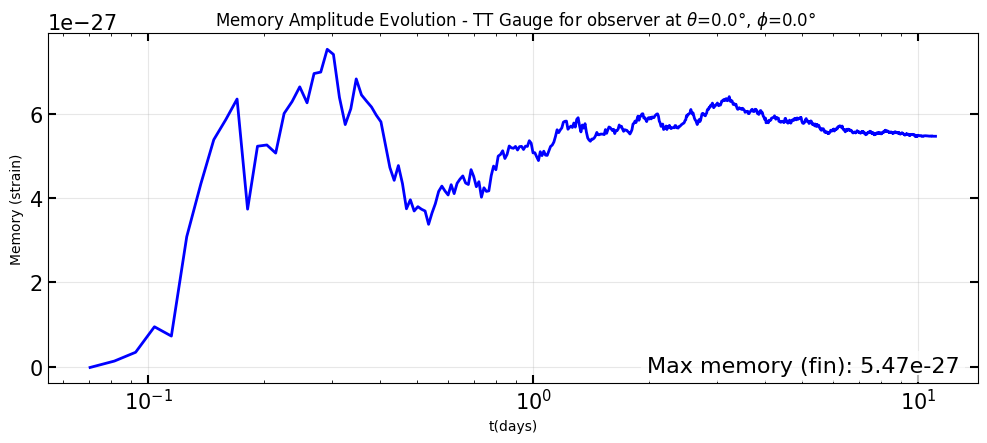

In [9]:
test_vec = np.array([0, 0, 1])  # Observateur sur le pole sud
t_centers_days, h_memory_vs_time = compute_memory_vs_time_TT(
    test_vec,
    nside=64,
    distance_Mpc=40.0,
    nbins_time=1000
)


Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz


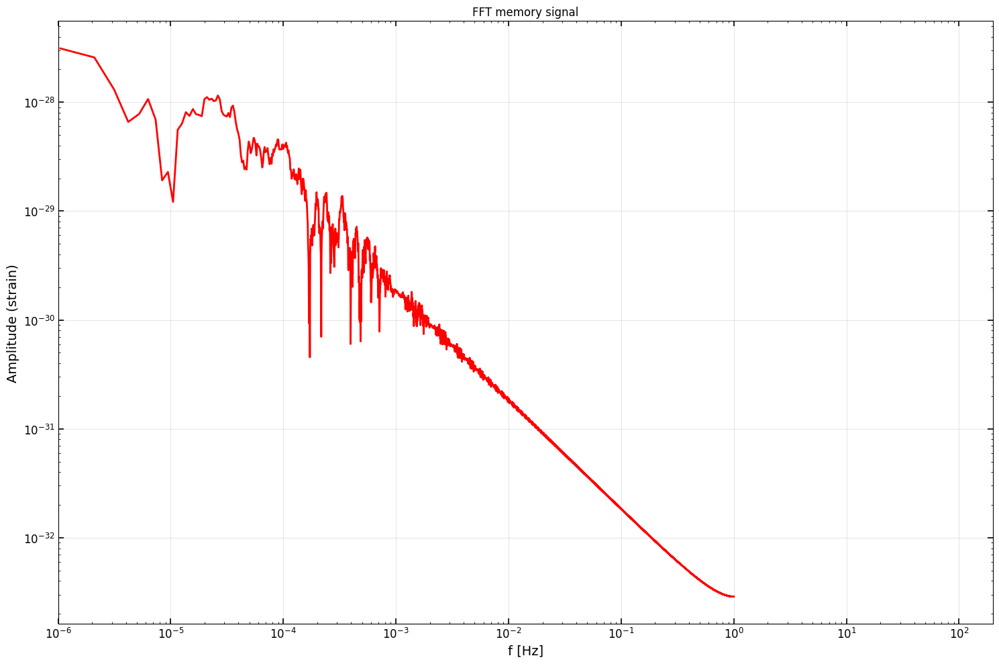

In [22]:
_,_= memory_fft(t_centers_days, h_memory_vs_time, window_type=False, plot_results=True)

Ce serait bien de faire une compaison de ce type de graph avec différentes directions (polaire vs équatoriale) pour voir la détectabilité de l'effet mémoire en fonction de l'angle.

Aussi jouer avec la distance et la masse pour voir directement l'impact sur la detection comme indique le graphique ci-dessous :

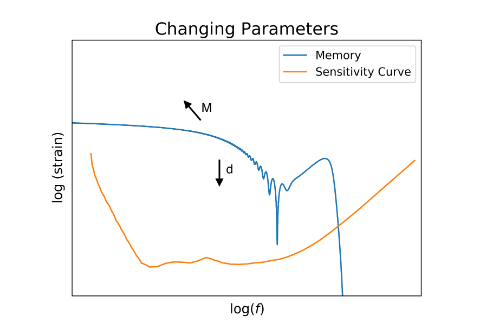

 (Credit : Johnson, A. D., Kapadia, S. J., Osborne, A., Hixon, A., & Kennefick, D. (2019). Prospects of detecting the nonlinear gravitational wave memory. Physical Review D, 99(4), 044045.)

In [8]:
# directions d'observation du pôle nord vers l'équateur
import os
theta_vals = np.linspace(0, np.pi/2, 6)  
test_vectors = [np.array([np.sin(th), 0.0, np.cos(th)]) for th in theta_vals if th != np.pi/2]


freq_all = []
fft_all = []
fft_labels = []

for vec in test_vectors:
    print("Observer vector:", vec)
    time_per_da, h_mem_time = compute_memory_vs_time_TT(
        vec,
        nside=64,
        distance_Mpc=40.0
    )

    # calcul de la fft (sans affichage interne)
    frequencies, fft_h = memory_fft(time_per_da, h_mem_time, window_type=False, plot_results=False)

    # stocker
    freq_all.append(frequencies)
    fft_all.append(fft_h)
    theta_deg = np.degrees(np.arccos(vec[2] / np.linalg.norm(vec)))
    fft_labels.append(f"{theta_deg:.1f}°")

# Plot de toutes les FFTs sur le même graphe
plt.figure(figsize=(10, 6))
cmap = plt.get_cmap('tab10')

for i, (f, a, lab) in enumerate(zip(freq_all, fft_all, fft_labels)):
    color = cmap(i /len(test_vectors))
    plt.loglog(f, a, color=color, lw=2, label=lab)

plt.xlabel('Frequency [Hz]')
plt.ylabel('FFT amplitude (strain)')
plt.title('FFT of memory signal for different observer directions')
plt.legend(title=rf'Observer $\theta$', fontsize=10)

plt.tight_layout()

outdir = "gw170817_memory_outputs"
os.makedirs(outdir, exist_ok=True)
plt.savefig(os.path.join(outdir, "memory_fft_by_direction_NH.png"), dpi=150, bbox_inches='tight')
plt.tick_params(top=True, right=True, axis='both', which='major', labelsize=15, direction='in', length=6, width=1.5)
plt.show()
    

Observer vector: [0. 0. 1.]


KeyboardInterrupt: 

Interval entre 0 et 10°

Observer vector: [0. 0. 1.]


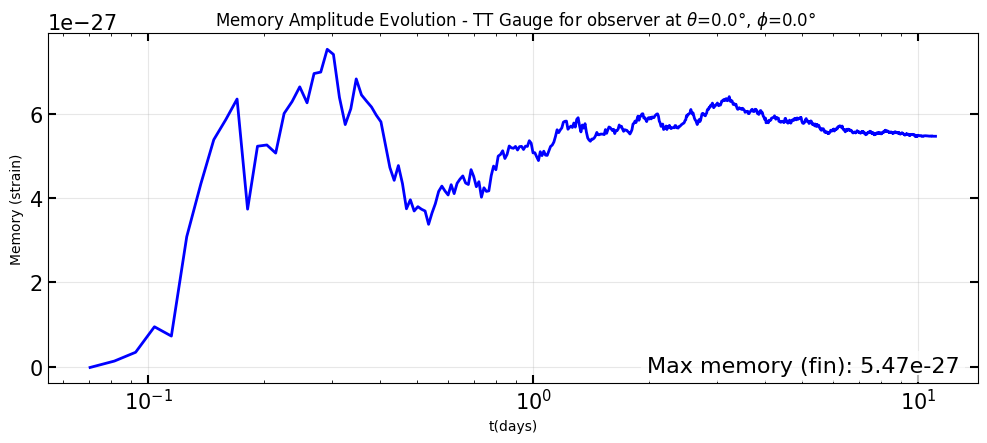

Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz
Observer vector: [0.04361939 0.         0.99904822]


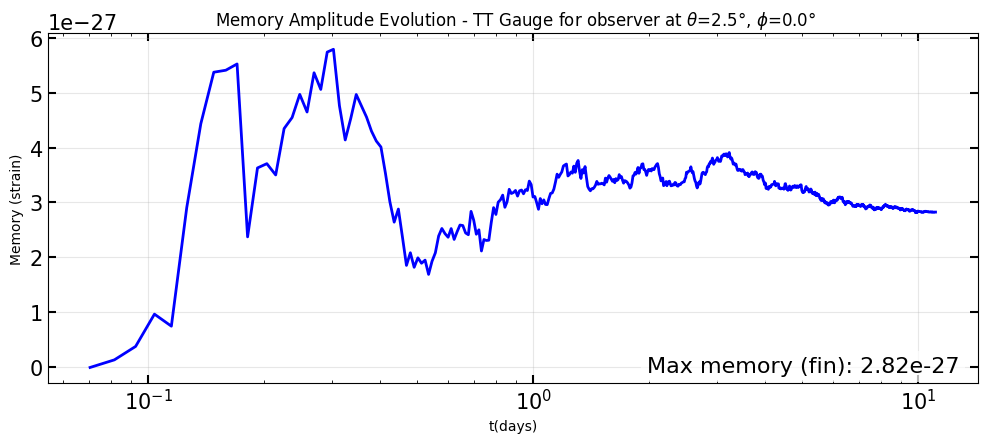

Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz
Observer vector: [0.08715574 0.         0.9961947 ]


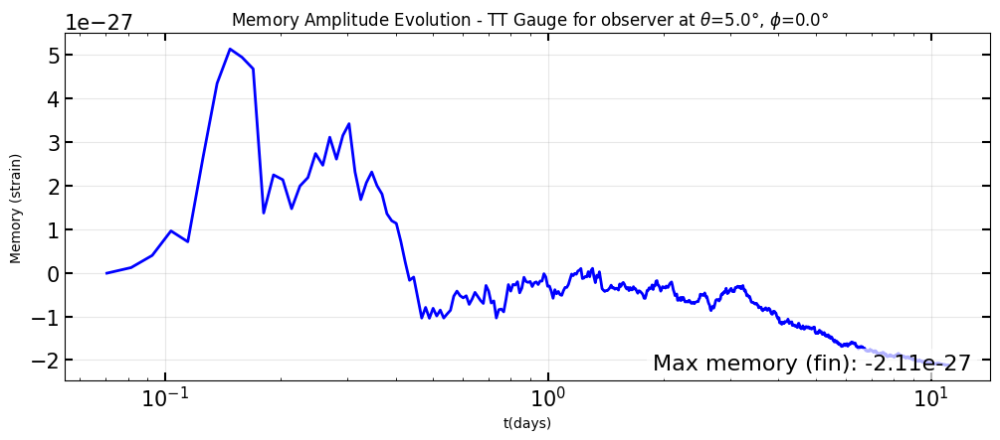

Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz
Observer vector: [0.13052619 0.         0.99144486]


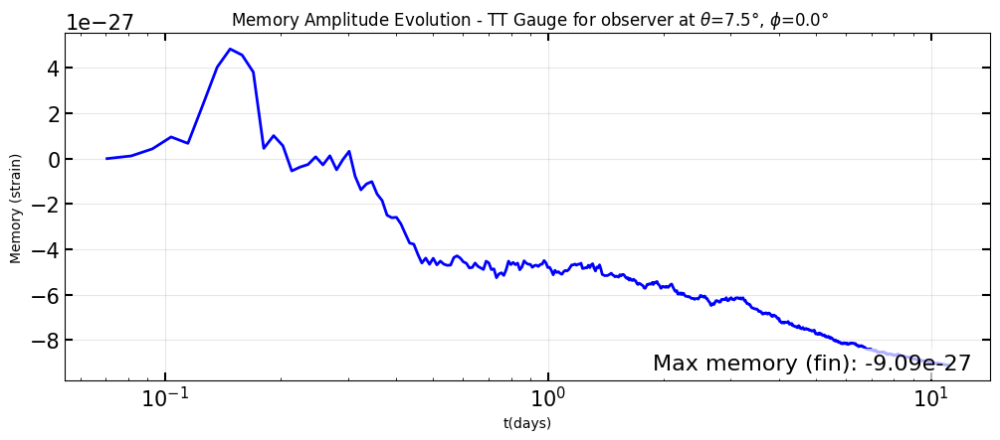

Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz
Observer vector: [0.17364818 0.         0.98480775]


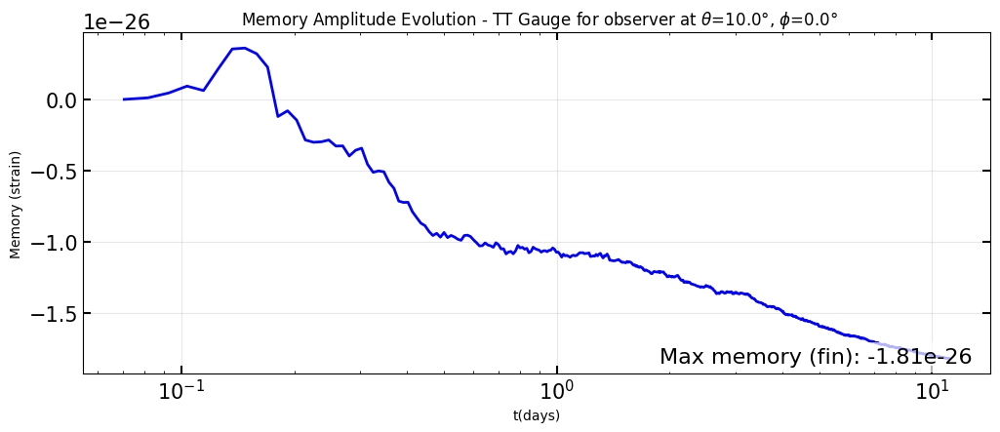

Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz


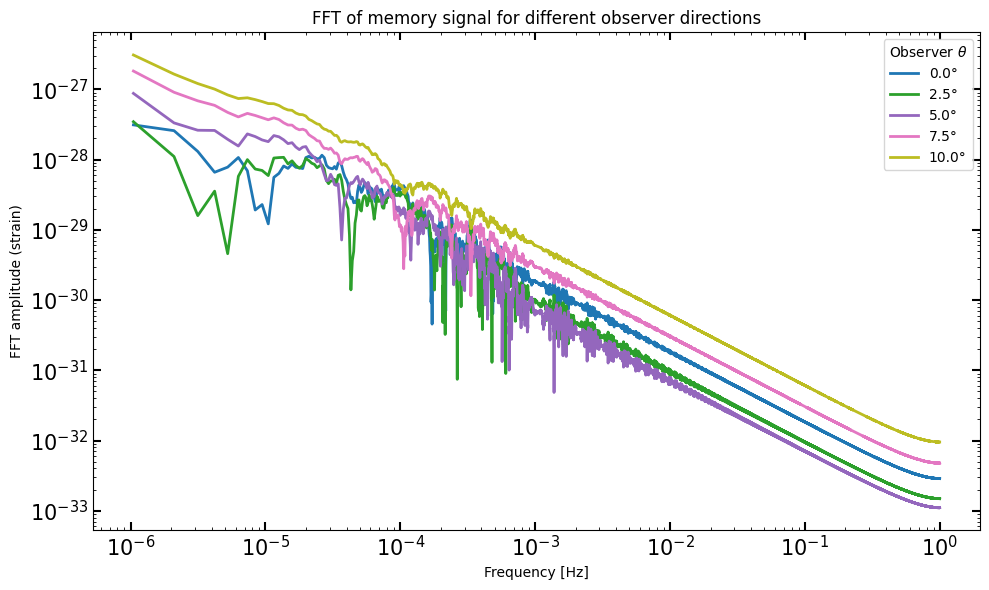

In [23]:
import os
theta_vals = np.linspace(0, 10, 5)  
test_vectors = [np.array([np.sin(np.radians(th)), 0.0, np.cos(np.radians(th))]) for th in theta_vals]


freq_all = []
fft_all = []
fft_labels = []

for vec in test_vectors:
    print("Observer vector:", vec)
    time_per_da, h_mem_time = compute_memory_vs_time_TT(
        vec,
        nside=64,
        distance_Mpc=40.0
    )

    # calcul de la fft (sans affichage interne)
    frequencies, fft_h = memory_fft(time_per_da, h_mem_time, window_type=False, plot_results=False)

    # stocker
    freq_all.append(frequencies)
    fft_all.append(fft_h)
    theta_deg = np.degrees(np.arccos(vec[2] / np.linalg.norm(vec)))
    fft_labels.append(f"{theta_deg:.1f}°")

# Plot de toutes les FFTs sur le même graphe
plt.figure(figsize=(10, 6))
cmap = plt.get_cmap('tab10')

for i, (f, a, lab) in enumerate(zip(freq_all, fft_all, fft_labels)):
    color = cmap(i /len(test_vectors))
    plt.loglog(f, a, color=color, lw=2, label=lab)

plt.xlabel('Frequency [Hz]')
plt.ylabel('FFT amplitude (strain)')
plt.title('FFT of memory signal for different observer directions')
plt.legend(title=rf'Observer $\theta$', fontsize=10)

plt.tight_layout()

outdir = "gw170817_memory_outputs"
os.makedirs(outdir, exist_ok=True)
plt.savefig(os.path.join(outdir, "memory_fft_by_direction_nearNP.png"), dpi=150, bbox_inches='tight')
plt.tick_params(top=True, right=True, axis='both', which='major', labelsize=15, direction='in', length=6, width=1.5)
plt.show()
    

Idem mais avec l'hémisphère sud

Observer vector: [ 0.95105652  0.         -0.30901699]


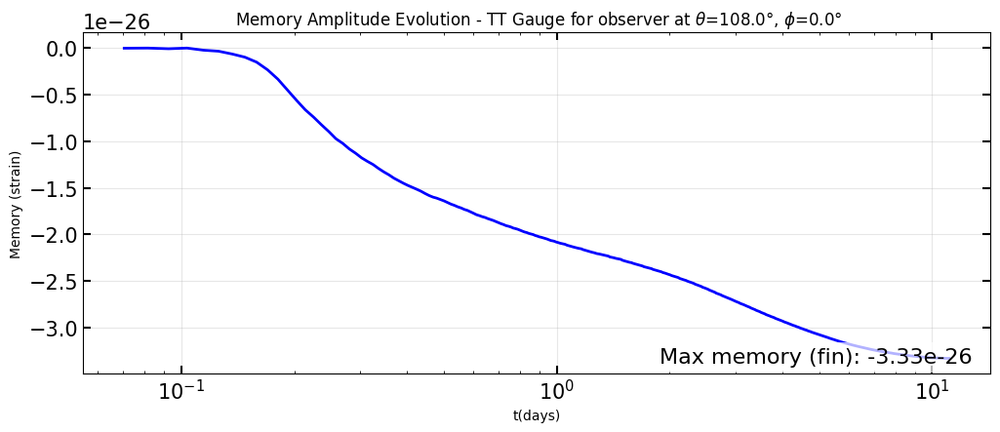

Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz
Observer vector: [ 0.80901699  0.         -0.58778525]


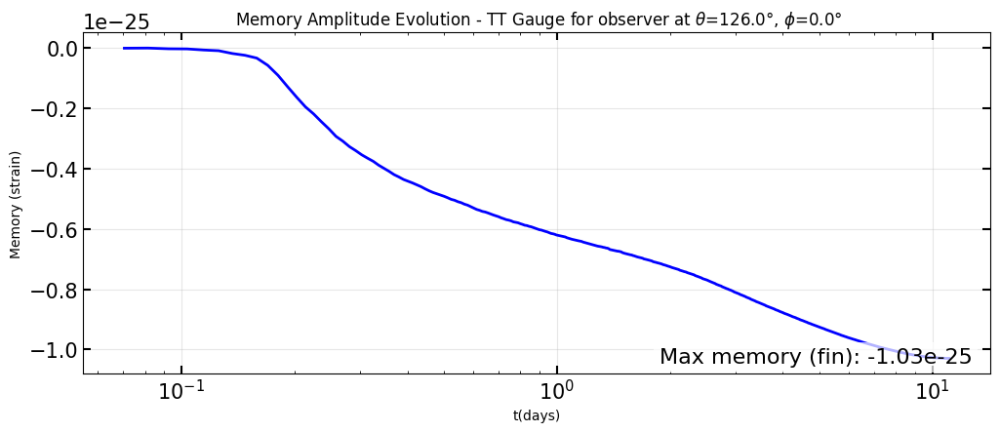

Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz
Observer vector: [ 0.58778525  0.         -0.80901699]


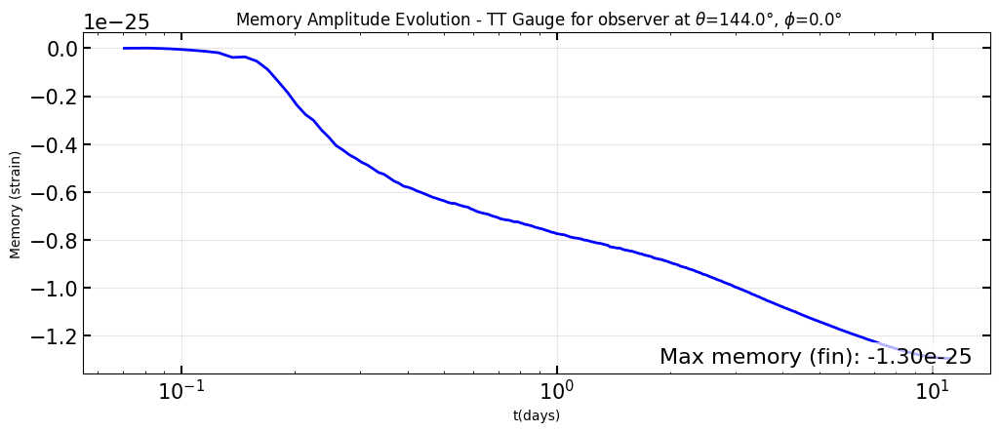

Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz
Observer vector: [ 0.30901699  0.         -0.95105652]


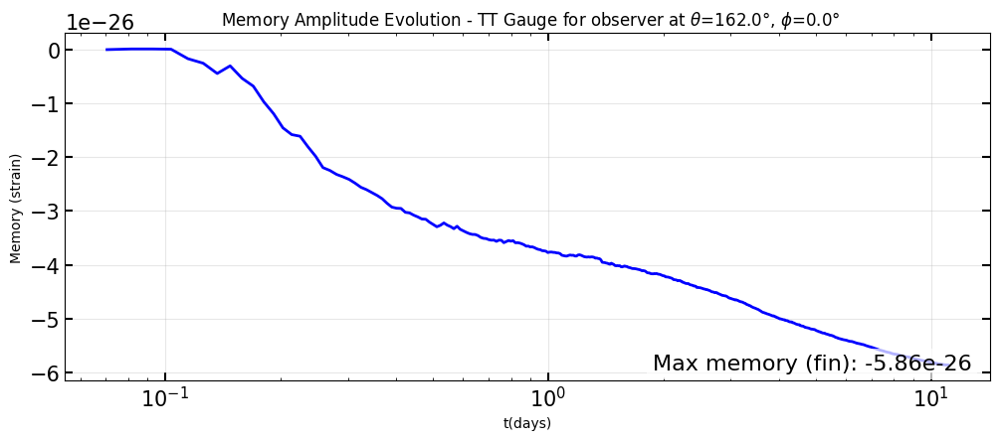

Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz
Observer vector: [ 1.2246468e-16  0.0000000e+00 -1.0000000e+00]


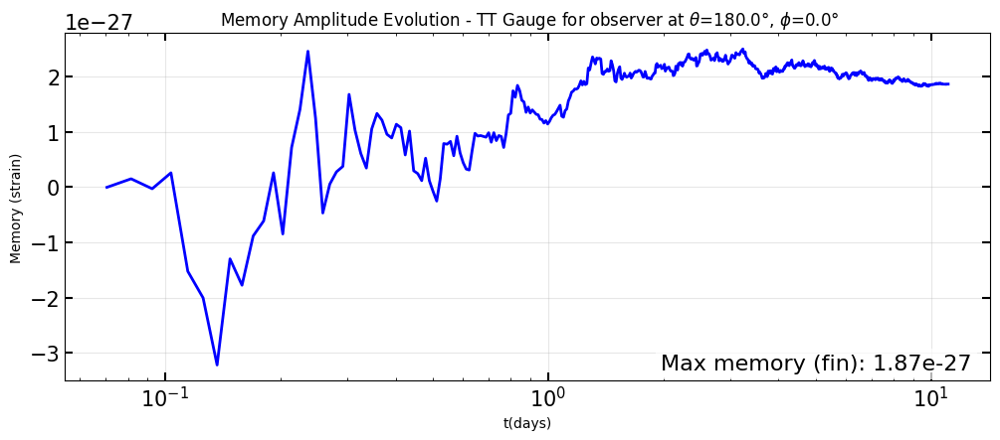

Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz


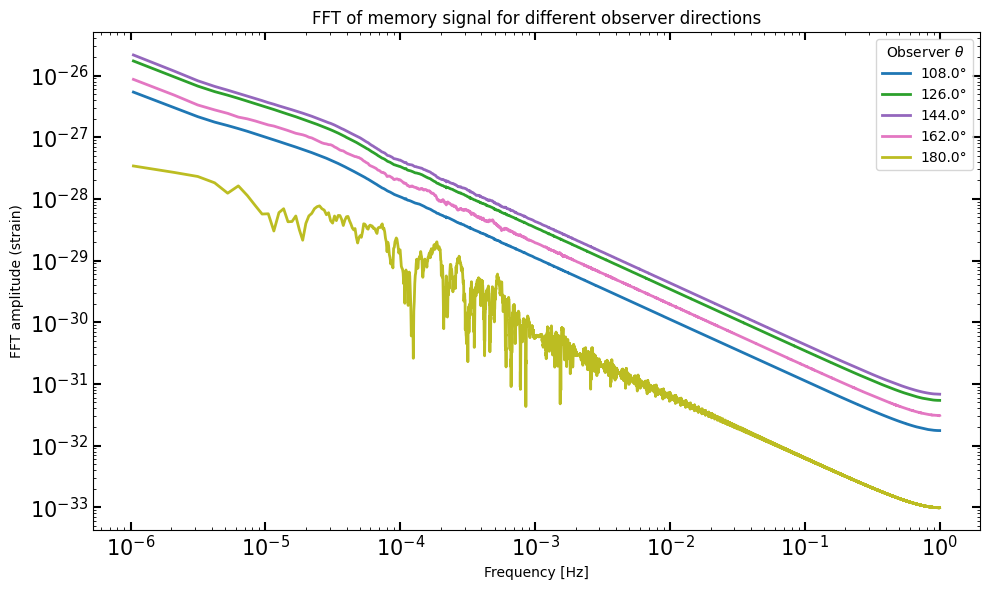

In [7]:
# directions d'observation de l'équateur vers le pôle sud
import os
theta_vals = np.linspace(np.pi/2, np.pi, 6)  
test_vectors = [np.array([np.sin(th), 0.0, np.cos(th)]) for th in theta_vals if th != np.pi/2]


freq_all = []
fft_all = []
fft_labels = []

for vec in test_vectors:
    print("Observer vector:", vec)
    time_per_da, h_mem_time = compute_memory_vs_time_TT(
        vec,
        nside=64,
        distance_Mpc=40.0
    )

    # calcul de la fft (sans affichage interne)
    frequencies, fft_h = memory_fft(time_per_da, h_mem_time, window_type=False, plot_results=False)

    # stocker
    freq_all.append(frequencies)
    fft_all.append(fft_h)
    theta_deg = np.degrees(np.arccos(vec[2] / np.linalg.norm(vec)))
    fft_labels.append(f"{theta_deg:.1f}°")

# Plot de toutes les FFTs sur le même graphe
plt.figure(figsize=(10, 6))
cmap = plt.get_cmap('tab10')

for i, (f, a, lab) in enumerate(zip(freq_all, fft_all, fft_labels)):
    color = cmap(i /len(test_vectors))
    plt.loglog(f, a, color=color, lw=2, label=lab)

plt.xlabel('Frequency [Hz]')
plt.ylabel('FFT amplitude (strain)')
plt.title('FFT of memory signal for different observer directions')
plt.legend(title=rf'Observer $\theta$', fontsize=10)

plt.tight_layout()

outdir = "gw170817_memory_outputs"
os.makedirs(outdir, exist_ok=True)
plt.savefig(os.path.join(outdir, "memory_fft_by_direction_SH.png"), dpi=150, bbox_inches='tight')
plt.tick_params(top=True, right=True, axis='both', which='major', labelsize=15, direction='in', length=6, width=1.5)
plt.show()
    

Observer vector: [ 0.17364818  0.         -0.98480775]


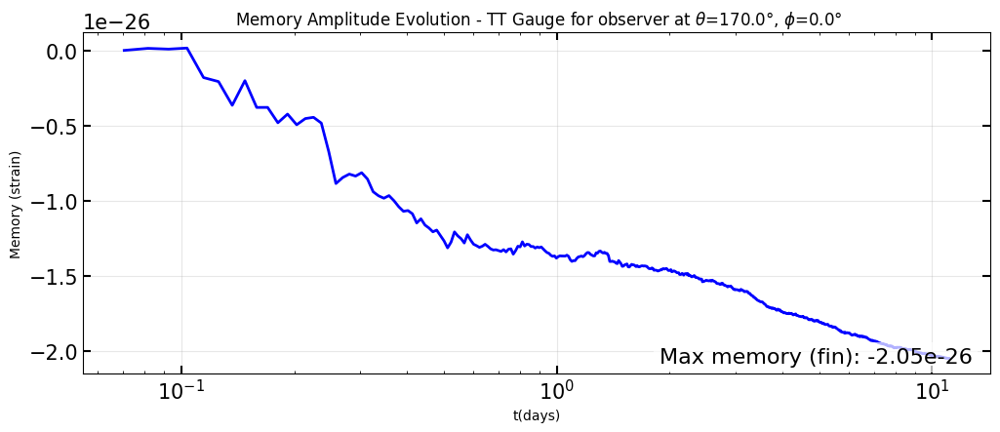

Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz
Observer vector: [ 0.13052619  0.         -0.99144486]


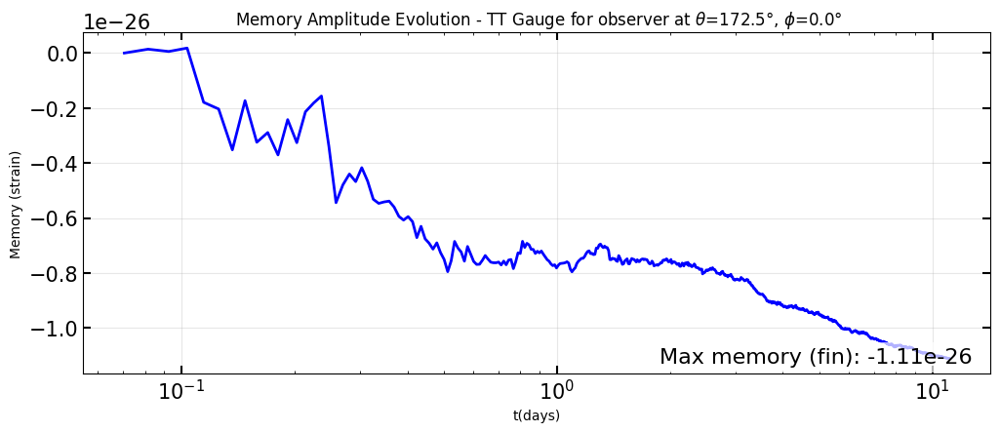

Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz
Observer vector: [ 0.08715574  0.         -0.9961947 ]


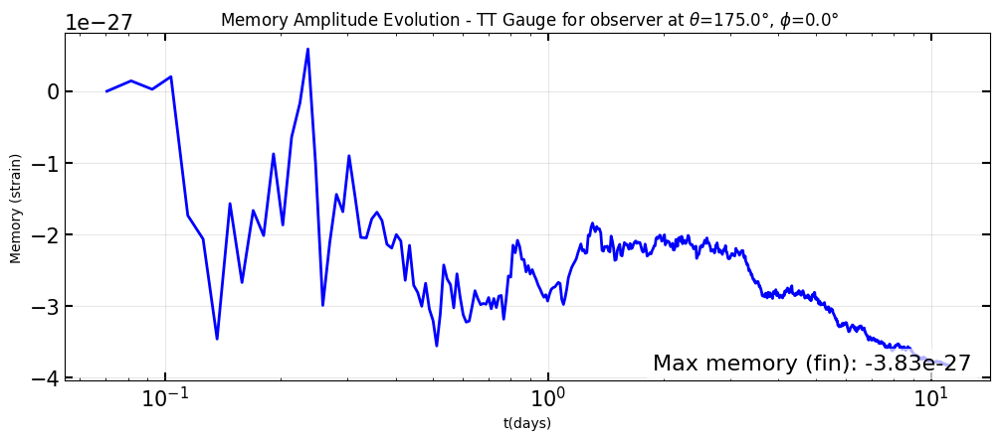

Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz
Observer vector: [ 0.04361939  0.         -0.99904822]


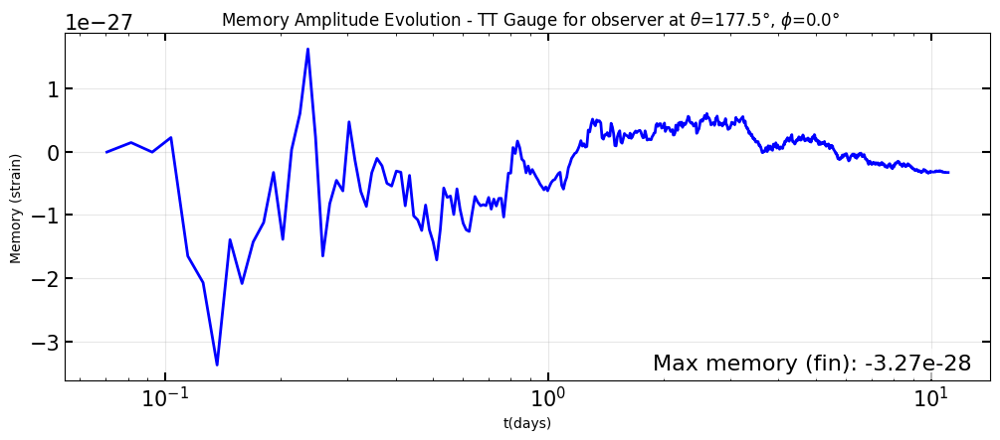

Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz
Observer vector: [ 1.2246468e-16  0.0000000e+00 -1.0000000e+00]


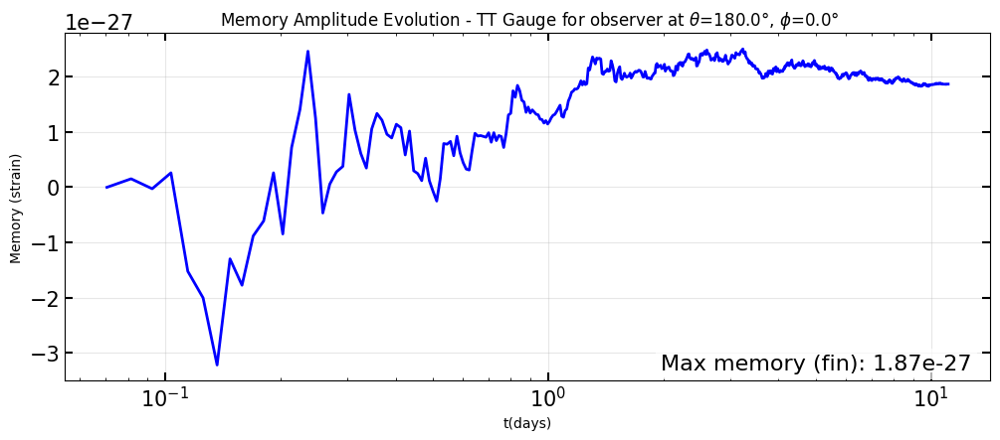

Ré-échantillonnage de la série temporelle pour atteindre Nyquist >= 1.0 Hz


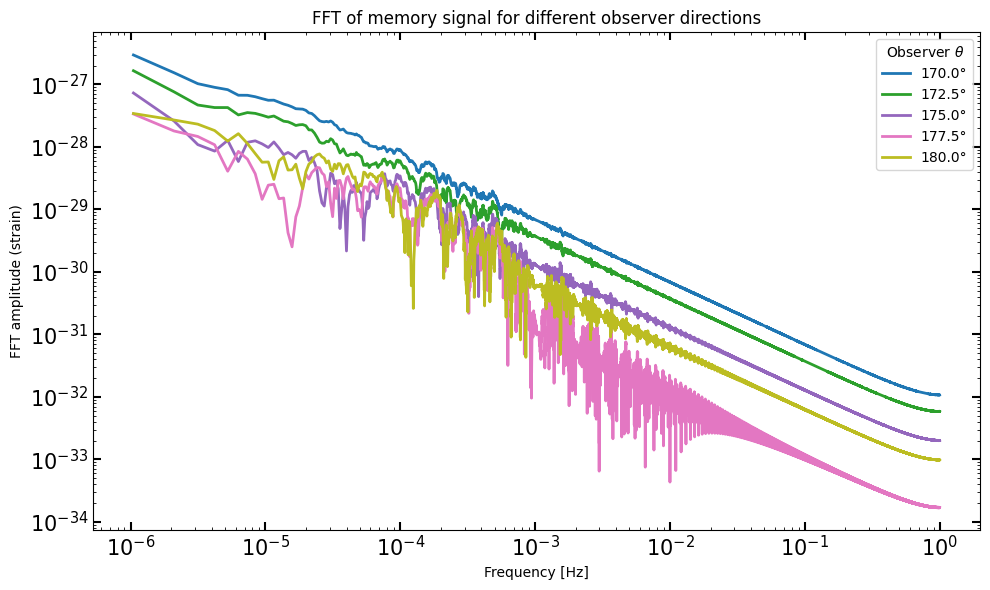

In [6]:
import os
theta_vals = np.linspace(170, 180, 5)  
test_vectors = [np.array([np.sin(np.radians(th)), 0.0, np.cos(np.radians(th))]) for th in theta_vals]


freq_all = []
fft_all = []
fft_labels = []

for vec in test_vectors:
    print("Observer vector:", vec)
    time_per_da, h_mem_time = compute_memory_vs_time_TT(
        vec,
        nside=64,
        distance_Mpc=40.0
    )

    # calcul de la fft (sans affichage interne)
    frequencies, fft_h = memory_fft(time_per_da, h_mem_time, window_type=False, plot_results=False)

    # stocker
    freq_all.append(frequencies)
    fft_all.append(fft_h)
    theta_deg = np.degrees(np.arccos(vec[2] / np.linalg.norm(vec)))
    fft_labels.append(f"{theta_deg:.1f}°")

# Plot de toutes les FFTs sur le même graphe
plt.figure(figsize=(10, 6))
cmap = plt.get_cmap('tab10')

for i, (f, a, lab) in enumerate(zip(freq_all, fft_all, fft_labels)):
    color = cmap(i /len(test_vectors))
    plt.loglog(f, a, color=color, lw=2, label=lab)

plt.xlabel('Frequency [Hz]')
plt.ylabel('FFT amplitude (strain)')
plt.title('FFT of memory signal for different observer directions')
plt.legend(title=rf'Observer $\theta$', fontsize=10)

plt.tight_layout()

outdir = "gw170817_memory_outputs"
os.makedirs(outdir, exist_ok=True)
plt.savefig(os.path.join(outdir, "memory_fft_by_direction_nearSP.png"), dpi=150, bbox_inches='tight')
plt.tick_params(top=True, right=True, axis='both', which='major', labelsize=15, direction='in', length=6, width=1.5)
plt.show()
    

# GIF de l'évolution temporelle de la mémoire selon angle d'observation

In [6]:
import os
import subprocess
from IPython.display import Image, display

def visualize_gif(gif_path, method='display'):
    """
    Visualise un GIF créé dans le notebook
    """
    
    # Vérifier que le fichier existe
    if not os.path.exists(gif_path):
        print(f" Le fichier {gif_path} n'existe pas")
        return
    if method == 'display':
        try:
            # Affichage dans le notebook Jupyter
            display(Image(filename=gif_path))
        except Exception as e:
            print(f" Erreur d'affichage: {e}")


Sauvegarde du GIF: gw170817_memory_outputs/memoryTT_viewing_angle_animation.gif


/tmp/ipykernel_810/55779170.py:153: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/tmp/ipykernel_810/55779170.py:153: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/tmp/ipykernel_810/55779170.py:153: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/tmp/ipykernel_810/55779170.py:153: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/tmp/ipykernel_810/55779170.py:153: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()
/tmp/ipykernel_810/55779170.py:153: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
 

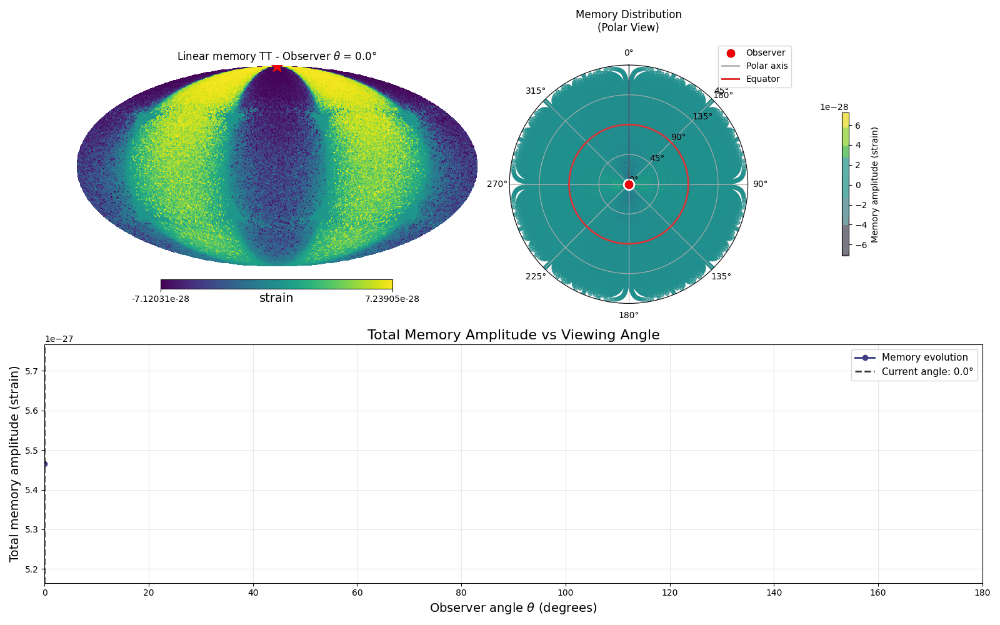

ok
Amplitude min: -1.32e-25 à 140.3°
Amplitude max: 5.47e-27 à 0.0°


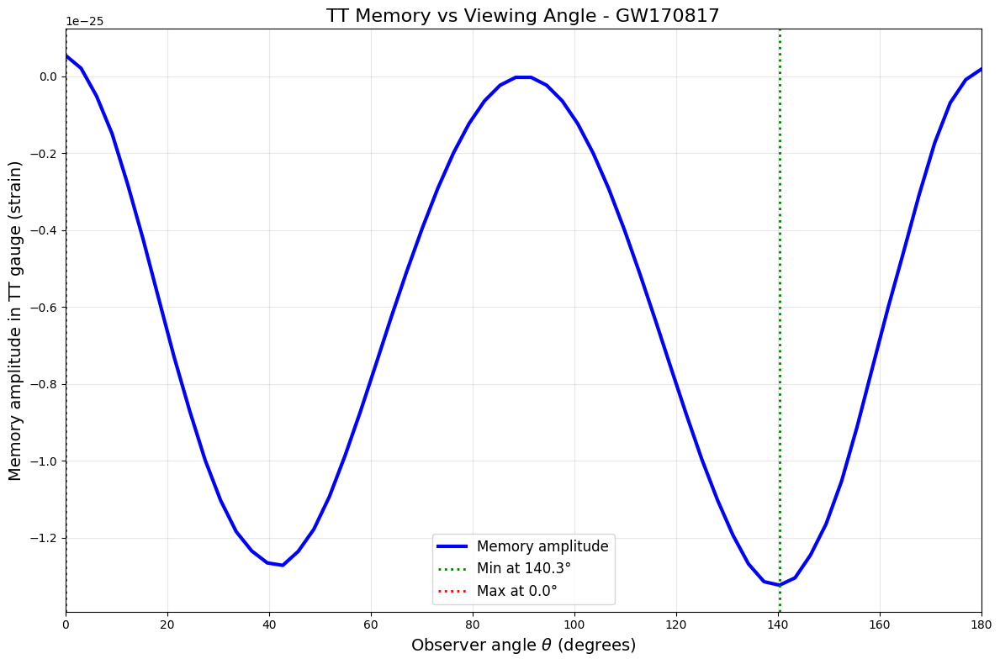

In [7]:
import numpy as np
import healpy as hp
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.animation import PillowWriter
import os
from lal import G_SI, PC_SI, C_SI 


def create_memory_gif():
    """
    Crée un GIF de l'effet mémoire en changeant obs_dir pour jauge TT
    """
    # Définir les angles d'observation (pôle nord -> équateur -> pôle sud)
    n_frames = 60
    theta_obs_array = np.linspace(0, np.pi, n_frames)  
    
    memory_maps = []  # Utiliser une liste pour stocker les cartes
    total_memory = np.zeros(n_frames)  # Mémoire totale pour chaque angle

    # Calculer toutes les cartes mémoire
    for i, theta_obs in enumerate(theta_obs_array):
        # obs_dir change selon l'angle
        obs_dir = np.array([np.sin(theta_obs), 0, np.cos(theta_obs)]) # direction de l'observateur (x,y,z)
        # On extrait la map mémoire + mémoire totale
        h_per_pixel, h_total = compute_linear_memory_TT(
            obs_dir, 
            nside=64, 
            distance_Mpc=40.0, 
            nbins_time=1000
        )
        
        memory_maps.append(h_per_pixel)  # Ajouter la carte à la liste
        total_memory[i] = h_total # Stocker la mémoire totale

    # Pré-calculer les données pour le diagramme polaire
    nside = 64
    npix = 12 * nside * nside
    pixel_vectors = np.array(hp.pix2vec(nside, np.arange(npix))).T
    pixel_theta = np.arccos(pixel_vectors[:, 2])  # angle polaire
    pixel_phi = np.arctan2(pixel_vectors[:, 1], pixel_vectors[:, 0])  # angle azimuthal
    
    all_memory_values = np.concatenate(memory_maps)  # Concaténer toutes les cartes en un seul array
    mask_nonzero = all_memory_values != 0
    # trouver les valeurs min et max en ignorant les zéros pour une meilleure échelle de couleur
    if np.any(mask_nonzero):
        vmin_hmap = np.min(all_memory_values[mask_nonzero])
        vmax_hmap = np.max(all_memory_values)
    else:
        vmin_hmap = np.min(all_memory_values)
        vmax_hmap = np.max(all_memory_values)

    
    # Créer l'animation
    fig = plt.figure(figsize=(16, 10))
    
    def animate(frame):
        fig.clear() 
        
        theta_obs = theta_obs_array[frame]
        h_map = memory_maps[frame]
        
        
        
        # PREMIÈRE LIGNE : MOLLVIEW ET DIAGRAMME POLAIRE
        
        # Carte mémoire Mollweide
        ax1 = plt.subplot(2, 2, (1, 1))
        hp.mollview(h_map, 
                   title=rf"Linear memory TT - Observer $\theta$ = {np.degrees(theta_obs):.1f}°",
                   unit="strain",
                   min=vmin_hmap, max=vmax_hmap,
                   norm='hist',
                   hold=True,
                   cmap='viridis',
                   sub=(2, 2, (1, 2)))
        
        # Marquer la position de l'observateur sur la carte
        obs_dir = np.array([np.sin(theta_obs), 0, np.cos(theta_obs)])
        obs_theta_hp = np.arccos(obs_dir[2])
        obs_phi_hp = np.arctan2(obs_dir[1], obs_dir[0])
        hp.projscatter(obs_theta_hp, obs_phi_hp, lonlat=False, 
                      marker='*', color='red', s=200, label='Observer')
        
        # Diagramme polaire avec amplitude mémoire (position 3)
        ax2 = plt.subplot(2, 2, (1,2), projection='polar')
        
        # Convertir h_map en coordonnées polaires pour l'affichage
        scatter = ax2.scatter(pixel_phi, pixel_theta, 
                                c=h_map, 
                                cmap='viridis', 
                                s=20, 
                                alpha=0.7,
                                vmin=vmin_hmap, vmax=vmax_hmap)
            
            # Colorbar pour le scatter
        cbar = plt.colorbar(scatter, ax=ax2, shrink=0.6, pad=0.1)
        cbar.set_label('Memory amplitude (strain)', fontsize=10)
        
        # Position de l'observateur sur le diagramme polaire
        obs_phi_polar = np.arctan2(obs_dir[1], obs_dir[0])
        obs_theta_polar = np.arccos(obs_dir[2])
        ax2.plot(obs_phi_polar, obs_theta_polar, 'ro', markersize=12, 
                label='Observer', markeredgecolor='white', markeredgewidth=2)
        

        ax2.plot([0, 0], [0, np.pi], 'k-', alpha=0.3, linewidth=2, label='Polar axis')
        
        phi_circle = np.linspace(0, 2*np.pi, 100)
        theta_equator = np.full_like(phi_circle, np.pi/2)
        ax2.plot(phi_circle, theta_equator, 'r-', alpha=0.7, linewidth=2, label='Equator')
        
        # Configuration du plot polaire
        ax2.set_ylim(0, np.pi)
        ax2.set_theta_direction(-1) # sens horaire
        ax2.set_theta_zero_location('N') # 0° en haut (nord)
        ax2.set_title('Memory Distribution\n(Polar View)', pad=20, fontsize=12)
        ax2.legend(loc='upper right', bbox_to_anchor=(1.2, 1.1), fontsize=10)
        
        # Ajouter des labels pour les angles theta
        ax2.set_rticks([0, np.pi/4, np.pi/2, 3*np.pi/4, np.pi])
        ax2.set_rlabel_position(45)
        ax2.set_rgrids([0, np.pi/4, np.pi/2, 3*np.pi/4, np.pi], 
                      ['0°', '45°', '90°', '135°', '180°'])
        
        #DEUXIÈME LIGNE : ÉVOLUTION DE LA MÉMOIRE TOTALE
        
        #  amplitude vs angle 
        ax3 = plt.subplot(2, 1, 2)  # Prend toute la largeur de la deuxième ligne
        
        amplitudes = total_memory[:frame+1]
        angles_deg = np.degrees(theta_obs_array[:frame+1])

        ax3.plot(angles_deg, amplitudes, 'b-o', markersize=6, linewidth=2, label='Memory evolution')
        ax3.axvline(np.degrees(theta_obs), color='black', linestyle='--', alpha=0.8, linewidth=2,
                   label=f'Current angle: {np.degrees(theta_obs):.1f}°')
        
       
        
        ax3.set_xlabel(rf'Observer angle $\theta$ (degrees)', fontsize=14)
        ax3.set_ylabel('Total memory amplitude (strain)', fontsize=14)
        ax3.set_title('Total Memory Amplitude vs Viewing Angle', fontsize=16)
        ax3.grid(True, alpha=0.3)
        ax3.set_xlim(0, 180)
        
        # Ajuster les limites y 
        if len(amplitudes) > 1:
            y_margin = 0.1 * (np.max(total_memory) - np.min(total_memory))
            ax3.set_ylim(np.min(total_memory) - y_margin, np.max(total_memory) + y_margin)
        
        ax3.legend(fontsize=11, loc='upper right')
        
        plt.tight_layout()
        
        return [ax1, ax2, ax3]
    
    # Créer l'animation
    anim = animation.FuncAnimation(fig, animate, frames=n_frames, 
                                 interval=150, blit=False, repeat=True)
    
    # Sauvegarder comme GIF
    outdir = "gw170817_memory_outputs"
    os.makedirs(outdir, exist_ok=True)
    
    gif_path = os.path.join(outdir, "memoryTT_viewing_angle_animation.gif")
    
    print(f"Sauvegarde du GIF: {gif_path}")
    try:
        writer = PillowWriter(fps=8)
        anim.save(gif_path, writer=writer, dpi=100)
        # Montre le gif dans le notebook
        visualize_gif(gif_path)
        print('ok')
    except Exception as e:
        print(f"Erreur  {e}")

    plt.close(fig)
    
    return gif_path, memory_maps, theta_obs_array, total_memory

# Exécuter l'animation
gif_path, memory_maps, angles, total_memory = create_memory_gif()

# Analyse des amplitudes
max_amplitudes = total_memory
min_angle_idx = np.argmin(max_amplitudes)
max_angle_idx = np.argmax(max_amplitudes)

print(f"Amplitude min: {max_amplitudes[min_angle_idx]:.2e} à {np.degrees(angles[min_angle_idx]):.1f}°")
print(f"Amplitude max: {max_amplitudes[max_angle_idx]:.2e} à {np.degrees(angles[max_angle_idx]):.1f}°")

# Graphique final de synthèse
plt.figure(figsize=(12, 8))
plt.plot(np.degrees(angles), max_amplitudes, 'b-', linewidth=3, label='Memory amplitude')
plt.axvline(np.degrees(angles[min_angle_idx]), color='green', linestyle=':', linewidth=2,
           label=f'Min at {np.degrees(angles[min_angle_idx]):.1f}°')
plt.axvline(np.degrees(angles[max_angle_idx]), color='red', linestyle=':', linewidth=2,
           label=f'Max at {np.degrees(angles[max_angle_idx]):.1f}°')



plt.xlabel(rf'Observer angle $\theta$ (degrees)', fontsize=14)
plt.ylabel('Memory amplitude in TT gauge (strain)', fontsize=14)
plt.title('TT Memory vs Viewing Angle - GW170817', fontsize=16)

plt.legend(fontsize=12)
plt.xlim(0, 180)
plt.grid(True, alpha=0.3)

plt.tight_layout()
outdir = "gw170817_memory_outputs"
os.makedirs(outdir, exist_ok=True)
plt.savefig(os.path.join(outdir, "memory_amplitude_vs_angle.png"), dpi=150, bbox_inches='tight')
plt.show()

***Remarque*** : Il doit avoir des erreurs pour la jauge TT car on devrait avoir annulation de la mémoire pour $\theta$ = 0 et  $\theta$ = $\pi$/2 vu l'expression (B.14) du papier. Or on observe pourtant une mémoire non nulle pour ces angles. Si on regarde l'expression de B.14 dans le plan XZ ($\phi$ = 0), 
$
(n^x n^x)^{\mathrm{TT}} = \frac{1}{2} (1 - \cos^2 \theta) 
$

Donc l'évolution angulaire de la mémoire devrait être proportionnelle à :
$
h_{+} \propto 1+ \cos(\theta)
$


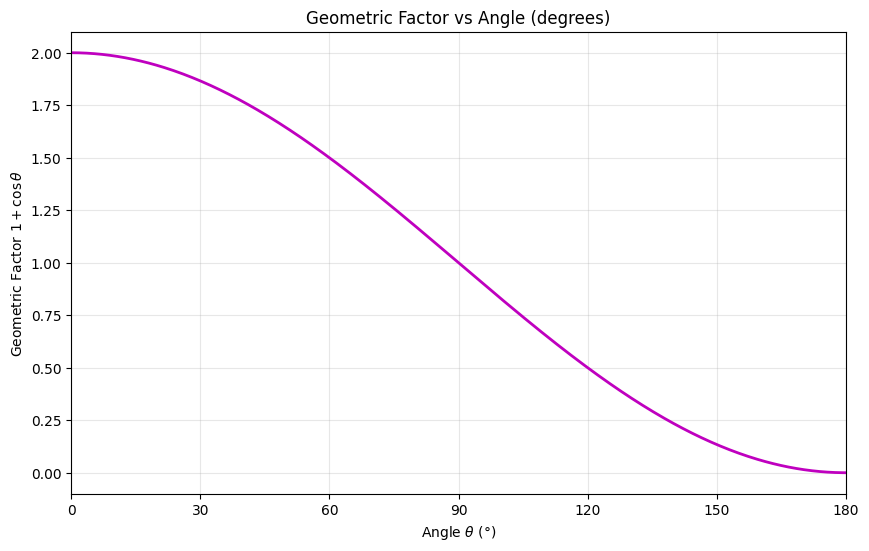

In [45]:
theta = np.linspace(0, np.pi, 500)

y = 1+ np.cos(theta)
theta_deg = np.degrees(theta)

plt.figure(figsize=(10, 6))
plt.plot(theta_deg, y, 'm-', linewidth=2)
plt.xlabel(r'Angle $\theta$ (°)')
plt.ylabel(rf'Geometric Factor $1+ \cos\theta$')
plt.title('Geometric Factor vs Angle (degrees)')
plt.xticks(np.arange(0, 361, 30))
plt.xlim(0, 180)
plt.grid(True, alpha=0.3)
plt.show()

Mais la formule analytique tentait de confirmer que la jauge TT était bien appliquée ?
- à revoir

Calculating memory for theta values: 100%|██████████| 61/61 [2:00:06<00:00, 118.14s/it]


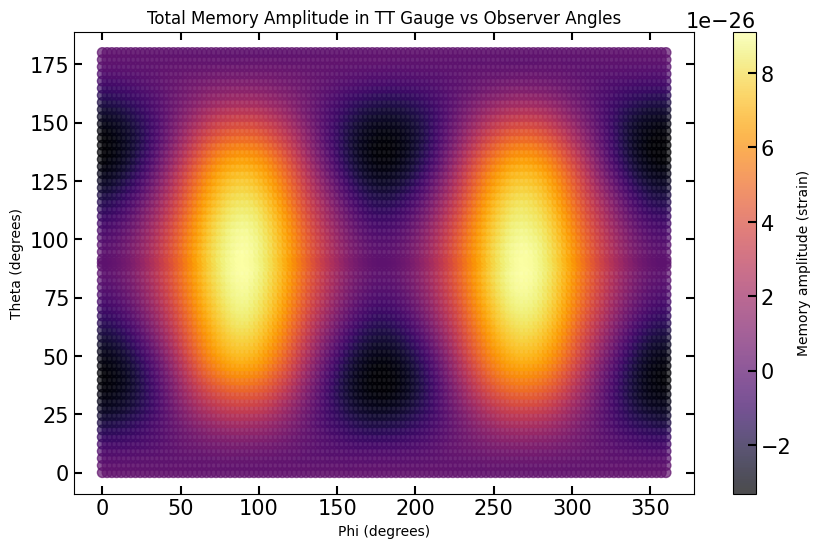

In [33]:
# Scatter plot de l'effet mémoire totale en fonction des 2 angles theta et phi
from tqdm import tqdm # Pour visualiser la progression des calculs
theta_vals = np.linspace(0, np.pi, 60)
# theta_vals doit passer par pi/2
theta_vals = np.sort(np.concatenate((theta_vals, [np.pi/2]))) # ajout de pi/2
phi_vals = np.linspace(0, 2*np.pi, 120)
memory_values = []
for theta in tqdm(theta_vals, desc="Calculating memory for theta values"):
    for phi in tqdm(phi_vals, desc="Calculating memory for phi values", leave=False):
        obs_dir = np.array([np.sin(theta)*np.cos(phi), np.sin(theta)*np.sin(phi), np.cos(theta)])
        _, h_total = compute_linear_memory_TT(
            obs_dir,
            nside=32,
            distance_Mpc=40.0,
            nbins_time=500
        )
        memory_values.append((theta, phi, h_total))

memory_values = np.array(memory_values)

# Scatter plot vs color = amplitude mémoire
plt.figure(figsize=(10, 6))
sc = plt.scatter(np.degrees(memory_values[:,1]), np.degrees(memory_values[:,0]), 
                 c=memory_values[:,2], cmap='inferno', s=50, alpha=0.7)
plt.colorbar(sc, label='Memory amplitude (strain)')
plt.xlabel('Phi (degrees)')
plt.ylabel('Theta (degrees)')
plt.title('Total Memory Amplitude in TT Gauge vs Observer Angles')

plt.show()
# sauvegarde de memory_value dans un fichier txt
import os
outdir = "gw170817_memory_outputs"
output_file = os.path.join(outdir, "memory_values_theta_phi_extended.txt")
np.savetxt(output_file, memory_values, header='Theta(rad) Phi(rad) Memory(strain)')

(1800, 3)


(7320, 3)
Nombre de valeurs nulles : 2
Memory min/max: -3.3102726572719776e-26 6.283185307179586


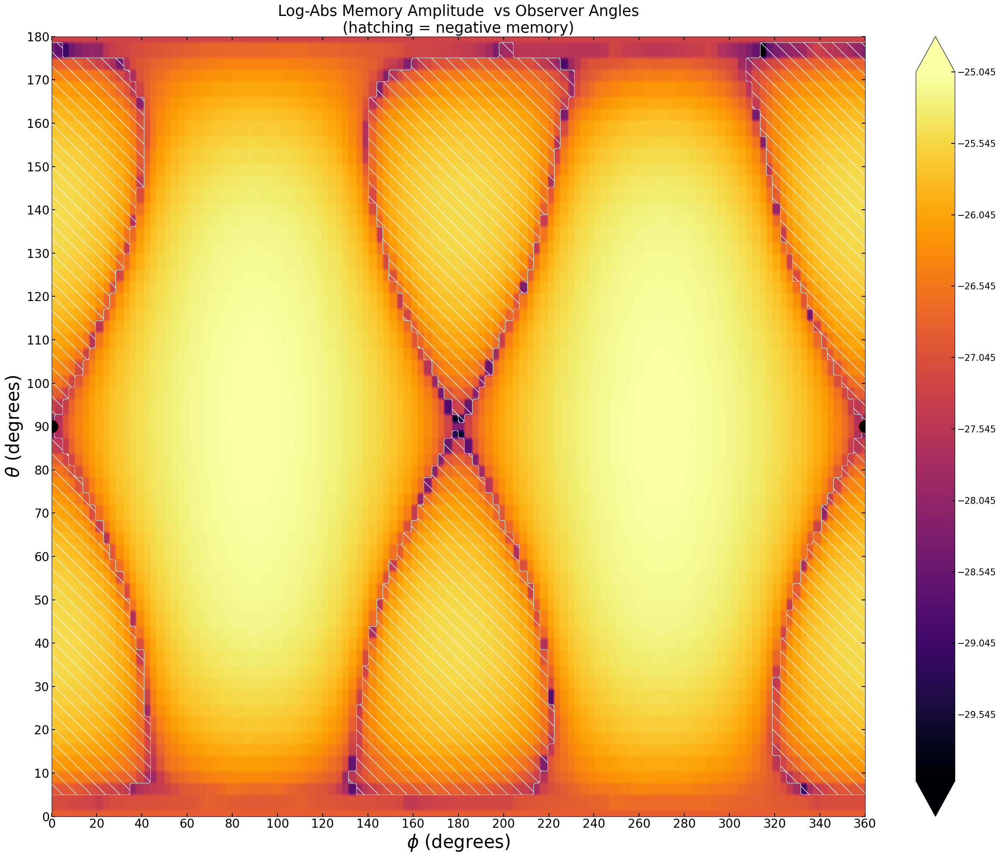

In [74]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import griddata
import os

# Préparation des données pour le contourf
memory_values_orign = np.loadtxt(os.path.join(outdir, "memory_values_theta_phi_extended.txt"))
memory_values = memory_values_orign.copy()
print(memory_values.shape)
theta_deg = np.degrees(memory_values[:,0])
phi_deg = np.degrees(memory_values[:,1])
mem_abs = np.abs(memory_values[:,2])
mem_sign = np.sign(memory_values[:,2])
no_null_mask = mem_abs > 1e-35 # pour le cas theta = 90 et phi = 0, on a une mémoire nulle vu plot précédent, donc je considère que si la mémoire est trop petite alors elle vaut 0
# Pour le cas de theta = 90 et phi = 0, on a une mémoire de l'ordre de 10^-55 -> on la met à zéro
mem_abs_nonzero = mem_abs[no_null_mask]
memory_zero = mem_abs[~no_null_mask]
print("Nombre de valeurs nulles :", memory_zero.shape[0])
# Création d'une grille régulière pour le contourf
theta_grid = np.linspace(theta_deg[no_null_mask].min(), theta_deg[no_null_mask].max(), 200)
phi_grid = np.linspace(phi_deg[no_null_mask].min(), phi_deg[no_null_mask].max(), 400)
Theta, Phi = np.meshgrid(theta_grid, phi_grid)
extend = [theta_deg[no_null_mask].min(), theta_deg[no_null_mask].max(), phi_deg[no_null_mask].min(), phi_deg[no_null_mask].max()]
vmin, vmax = memory_values.min(), memory_values.max()
print("Memory min/max:", vmin, vmax)
# Interpolation sur la grille régulière
mem_grid = griddata((theta_deg[no_null_mask], phi_deg[no_null_mask]), np.log10(mem_abs_nonzero), (Theta, Phi), method='nearest')
#zero_mem_grid = griddata((memory_zero[:,0], memory_zero[:,1]), memory_zero[:,2], (Theta, Phi), method='nearest')
sign_grid = griddata((theta_deg, phi_deg), mem_sign, (Theta, Phi), method='nearest')

plt.figure(figsize=(25, 20))

cont = plt.contourf(Phi, Theta, mem_grid, levels=1000, cmap='inferno', extend='both')
cbar = plt.colorbar(cont)

# Hachures pour les zones négatives + zéro
fig1 =plt.contourf(Phi, Theta, sign_grid, hatches=['\\'], levels=[-1.5, -0.0], colors='none') # hachure pour signe entre -1 et 0
fig1._hatch_color= (1,4,4,1.0)
plt.contourf(Phi, Theta, sign_grid, levels=[-0.01, 0.01], colors='white') # zone nulle quand le signe est proche de 0

# Ajout d'un point pour les valeurs nulles
if memory_zero.shape[0] > 0:
    plt.scatter(np.degrees(memory_values_orign[~no_null_mask,1]), np.degrees(memory_values_orign[~no_null_mask,0]), 
                color='black', edgecolor='red', s=500, label='Zero memory points', marker="o")

# ticks toutes les 10 degrés
plt.xticks(np.arange(0, 361, 20), fontsize=20)
plt.yticks(np.arange(0, 181, 10), fontsize=20)
plt.xlabel(rf'$\phi$ (degrees)', fontsize=30)
plt.ylabel(rf'$\theta$ (degrees)', fontsize=30)
plt.title('Log-Abs Memory Amplitude  vs Observer Angles\n(hatching = negative memory)', fontsize=25)

# Sauvegarde du plot
outdir = "gw170817_memory_outputs"
os.makedirs(outdir, exist_ok=True)
plt.savefig(os.path.join(outdir, "memory_contourf_theta_phi_extended.png"), dpi=150)

plt.tight_layout()
plt.show()


In [14]:
# Regarder la valeur de la mémoire quand theta = 90° et phi = 0° (équateur, x-axis)
theta_eq = 90.0
phi_eq = 0.0
# Trouver l'index le plus proche
idx_eq = np.argmin(np.abs(theta_deg - theta_eq) + np.abs(phi_deg - phi_eq))
mem_eq = memory_values[idx_eq, 2]
print(f"Memory amplitude at theta={theta_eq}°, phi={phi_eq}°: {mem_eq:.2e} strain")

Memory amplitude at theta=90.0°, phi=0.0°: -1.24e-57 strain


---

Problème : L'effet mémoire (linéaire ici) est inclus dans le signal GW, donc on ne doit calculer que sur la temps très court après le merger/ début de la kilonova. Or on calcule sur toute la durée de la simulation (10 jours) donc on intègre aussi des contributions qui ne devraient pas être là dans la waveform. 

In [4]:
from lal import G_SI, PC_SI, C_SI
import numpy as np
import healpy as hp
import matplotlib.pyplot as plt

def compute_memory_vs_time_TT(obs_dir, nside=64, distance_Mpc=40.0, nbins_time=1000, t_max_days=1.0):
    """
    Calcule l'effet mémoire linéaire TT en fonction du temps, tronqué à t_max_days.
    
    Parameters:
    - obs_dir: direction de l'observateur (array 3D)
    - nside: résolution HEALPix
    - distance_Mpc: distance en Mpc
    - nbins_time: nombre de bins temporels
    - t_max_days: temps maximum en jours pour tronquer les données (défaut: 1.0)
    """
    
    r_m = distance_Mpc * 1e6 * PC_SI
    deltaOmega = 4 * np.pi / npix

    # Filtrer les données pour t_days <= t_max_days
    mask_time = t_days <= t_max_days
    t_s_filtered = t_s[mask_time]
    e_J_filtered = e_J[mask_time]
    pix_filtered = pix[mask_time]
    
    # Si aucune donnée après filtrage, retourner des arrays vides
    if len(t_s_filtered) == 0:
        print(f"Aucune donnée pour t <= {t_max_days} jours.")
        return np.array([]), np.array([])

    # Binning temporel sur les données filtrées
    t_bins = np.linspace(t_s_filtered.min(), t_s_filtered.max(), nbins_time)
    t_centers = 0.5 * (t_bins[1:] + t_bins[:-1])
    t_centers_days = t_centers / day_to_s
    dt = np.median(np.diff(t_bins))
    nt = len(t_bins) - 1

    maps_J = np.zeros((nt, npix))
    for i in range(nt):
        mask = (t_s_filtered >= t_bins[i]) & (t_s_filtered < t_bins[i + 1])
        np.add.at(maps_J[i], pix_filtered[mask], e_J_filtered[mask])

    dE_dt = maps_J / dt  
    dL_dOmega = dE_dt / deltaOmega

    vecs = np.array(hp.pix2vec(nside, np.arange(npix))).T
    factor = 4.0 * G_SI / (r_m * C_SI**4)
    eps = 1e-8

    tt_tensors = np.zeros((npix, 3, 3))
    geometric_factors = np.zeros(npix)
    
    for p in range(npix):
        n_vec = vecs[p]
        cos_theta = np.dot(n_vec, obs_dir)
        den = 1.0 - cos_theta
        if den < eps:
            den = eps
        
        geometric_factors[p] = 1.0 / den
        tt_tensors[p] = TT_projection(np.outer(n_vec, n_vec), obs_dir)

    # Calcul de la mémoire en fonction du temps
    h_memory_vs_time = np.zeros(nt)
    cumulative_dL = np.zeros((nt, npix))
    
    for t_idx in range(nt):
        if t_idx == 0:
            cumulative_dL[t_idx] = dL_dOmega[t_idx] * dt
        else:
            cumulative_dL[t_idx] = cumulative_dL[t_idx-1] + dL_dOmega[t_idx] * dt

        h_total_at_time = 0.0
        for p in range(npix):
            if cumulative_dL[t_idx, p] == 0:
                continue
            h_tensor = factor * cumulative_dL[t_idx, p] * tt_tensors[p] * geometric_factors[p]
            h_plus = -h_tensor[0, 0]
            h_total_at_time += h_plus
        h_memory_vs_time[t_idx] = h_total_at_time

    # Plot 
    valid_mask = np.isfinite(h_memory_vs_time)
    obs_theta = np.arccos(obs_dir[2])
    obs_phi = np.arctan2(obs_dir[1], obs_dir[0])
    
    if np.any(valid_mask):
        plt.figure(figsize=(12, 10))
        plt.subplot(2, 1, 1)
        plt.semilogx(t_centers_days[valid_mask], h_memory_vs_time[valid_mask], 'b-', linewidth=2)
        plt.xlabel('t(days)')
        plt.ylabel('Memory (strain)')
        plt.title(f'Memory Amplitude Evolution - TT Gauge for observer at theta={np.degrees(obs_theta):.1f}°, phi={np.degrees(obs_phi):.1f}° (t_max={t_max_days}d)')
        plt.grid(True, alpha=0.3)

        max_memory = h_memory_vs_time[valid_mask][-1]
        plt.text(0.98, 0.02, f"Max memory (fin): {max_memory:.2e}", transform=plt.gca().transAxes, fontsize=16, color='black', ha='right', va='bottom', bbox=dict(facecolor='white', alpha=0.7, edgecolor='none'))
        
        plt.show()
    
    return t_centers_days, h_memory_vs_time

/tmp/ipykernel_6363/2263546330.py:1: UserWarning: Wswiglal-redir-stdio:

SWIGLAL standard output/error redirection is enabled in IPython.
This may lead to performance penalties. To disable locally, use:

with lal.no_swig_redirect_standard_output_error():
    ...

To disable globally, use:

lal.swig_redirect_standard_output_error(False)

Note however that this will likely lead to error messages from
LAL functions being either misdirected or lost when called from
Jupyter notebooks.

To suppress this warning, use:

import warnings
warnings.filterwarnings("ignore", "Wswiglal-redir-stdio")
import lal

  from lal import G_SI, PC_SI, C_SI


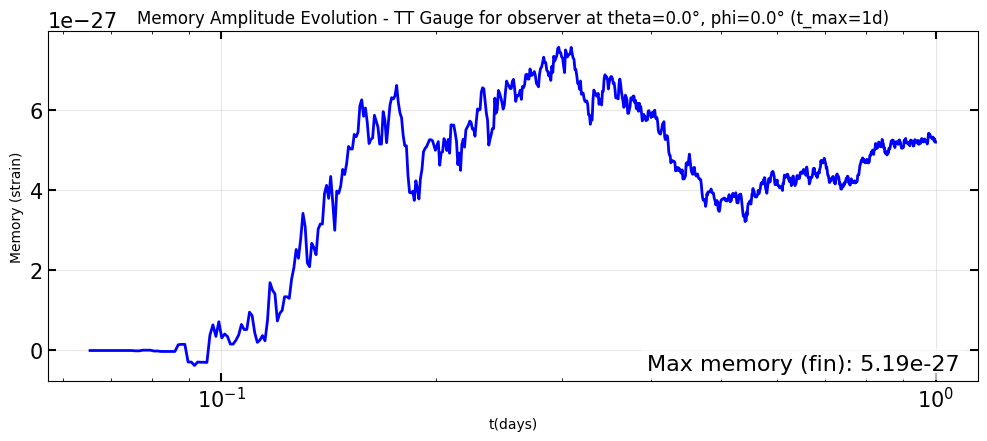

In [5]:
# calcul mémoire pour t_max = 1 j
_,_ =compute_memory_vs_time_TT(
    np.array([0, 0, 1]),  # Observateur sur le pole nord
    nside=64,
    distance_Mpc=40.0,
    nbins_time=1000,
    t_max_days= 1
)

In [9]:
# temps minimale de la simulation 
t_days_min = t_days.min()
# temps min en secondes
t_s_min = t_days_min * day_to_s
print(f"Temps minimum de la simulation : {t_days_min} jours = {t_s_min} secondes")

Temps minimum de la simulation : 0.065 jours = 5616.0 secondes
